In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
print("Importing MONAI")
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Importing MONAI


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 4), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)
   
    def training_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars(ExperimentDescription, {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='I-AE{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])

In [3]:
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir   = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc) # , num_workers=1
val_dataset   = CacheDataset(val_dataset_uc  ) # , num_workers=1

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True ) # ,  num_workers=1
val_dataloader   = DataLoader(val_dataset,   batch_size=1, shuffle=False) # ,  num_workers=1

Loading dataset:   0%|          | 0/18 [00:00<?, ?it/s]

Loading dataset:   6%|▌         | 1/18 [00:03<00:57,  3.40s/it]

Loading dataset:  11%|█         | 2/18 [00:09<01:16,  4.76s/it]

Loading dataset:  17%|█▋        | 3/18 [00:12<01:03,  4.25s/it]

Loading dataset:  22%|██▏       | 4/18 [00:16<00:55,  3.95s/it]

Loading dataset:  28%|██▊       | 5/18 [00:20<00:54,  4.19s/it]

Loading dataset:  33%|███▎      | 6/18 [00:25<00:50,  4.25s/it]

Loading dataset:  39%|███▉      | 7/18 [00:28<00:43,  3.99s/it]

Loading dataset:  44%|████▍     | 8/18 [00:33<00:41,  4.18s/it]

Loading dataset:  50%|█████     | 9/18 [00:37<00:38,  4.32s/it]

Loading dataset:  56%|█████▌    | 10/18 [00:41<00:31,  3.99s/it]

Loading dataset:  61%|██████    | 11/18 [00:44<00:26,  3.75s/it]

Loading dataset:  67%|██████▋   | 12/18 [00:51<00:28,  4.75s/it]

Loading dataset:  72%|███████▏  | 13/18 [00:54<00:21,  4.38s/it]

Loading dataset:  78%|███████▊  | 14/18 [01:01<00:20,  5.19s/it]

Loading dataset:  83%|████████▎ | 15/18 [01:13<00:21,  7.04s/it]

Loading dataset:  89%|████████▉ | 16/18 [01:20<00:14,  7.01s/it]

Loading dataset:  94%|█████████▍| 17/18 [01:26<00:06,  6.88s/it]

Loading dataset: 100%|██████████| 18/18 [01:32<00:00,  6.41s/it]

Loading dataset: 100%|██████████| 18/18 [01:32<00:00,  5.12s/it]

Loading dataset:   0%|          | 0/8 [00:00<?, ?it/s]

Loading dataset:  12%|█▎        | 1/8 [00:05<00:40,  5.78s/it]

Loading dataset:  25%|██▌       | 2/8 [00:18<00:58,  9.68s/it]

Loading dataset:  38%|███▊      | 3/8 [00:24<00:39,  7.92s/it]

Loading dataset:  50%|█████     | 4/8 [00:33<00:34,  8.71s/it]

Loading dataset:  62%|██████▎   | 5/8 [00:39<00:23,  7.69s/it]

Loading dataset:  75%|███████▌  | 6/8 [00:47<00:15,  7.54s/it]

Loading dataset:  88%|████████▊ | 7/8 [00:54<00:07,  7.56s/it]

Loading dataset: 100%|██████████| 8/8 [01:02<00:00,  7.67s/it]

Loading dataset: 100%|██████████| 8/8 [01:02<00:00,  7.82s/it]

In [4]:
trainer = pl.Trainer(
    max_epochs=1501,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


Missing logger folder: /old_Users/tgafrick/RA4/jobs/job12/lightning_logs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 2.1 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
2.1 M     Trainable params
0         Non-trainable params
2.1 M     Total params
8.362     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=55` in the `DataLoader` to improve performance.


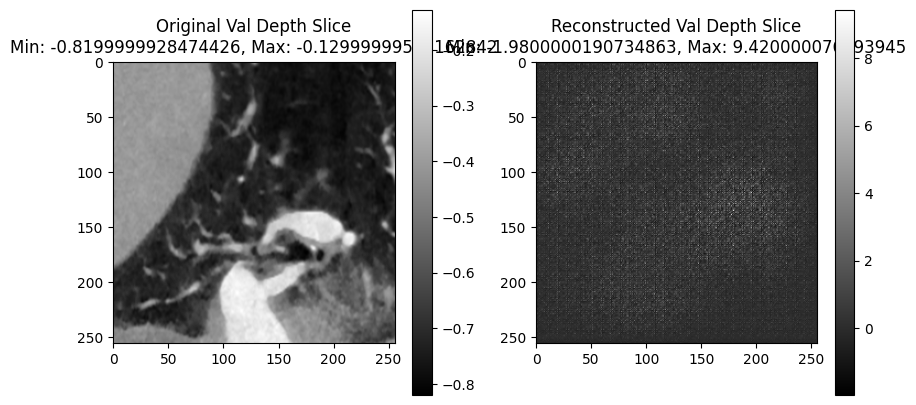

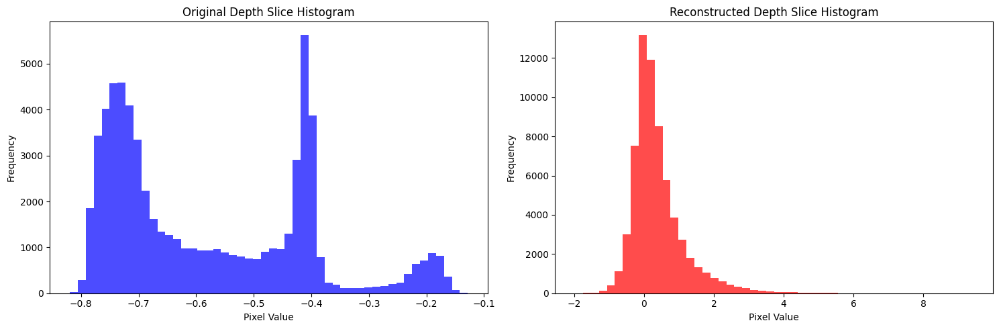

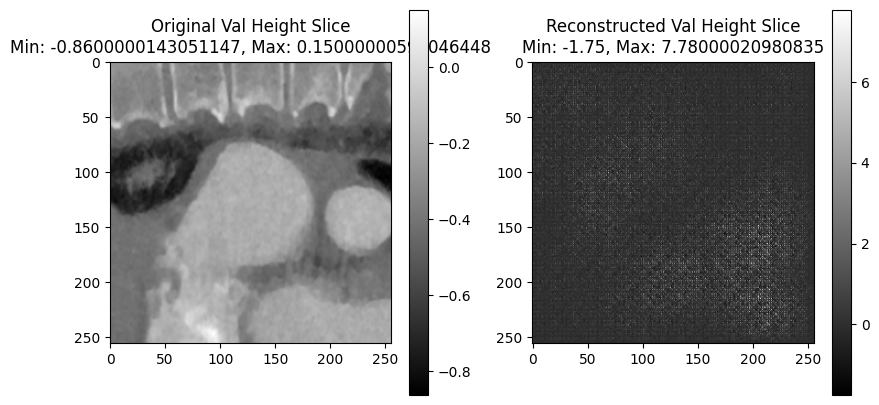

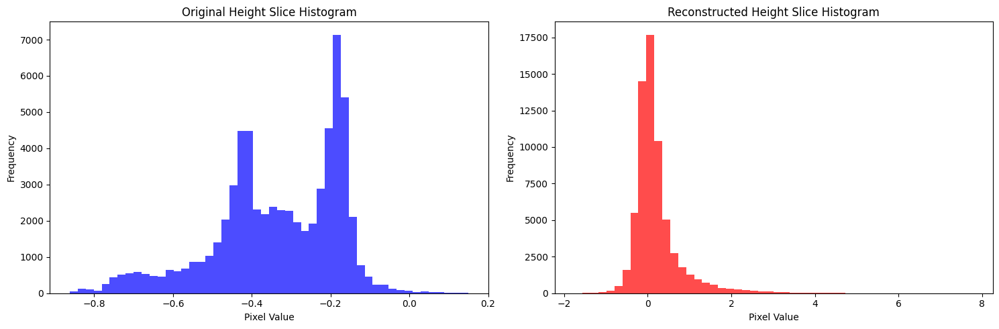

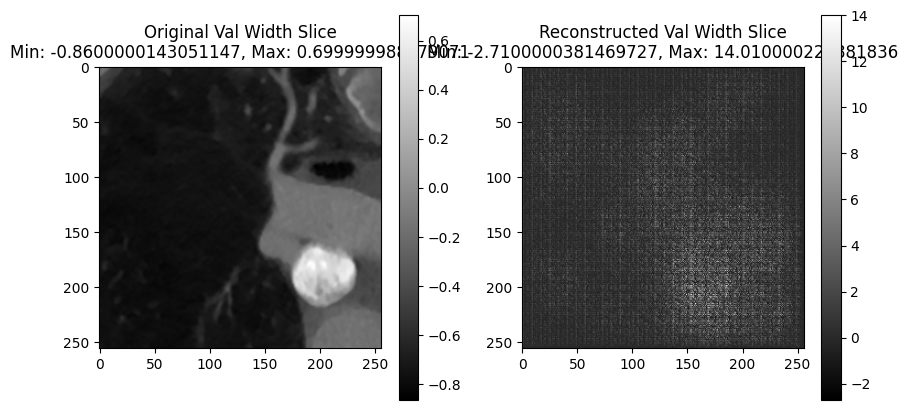

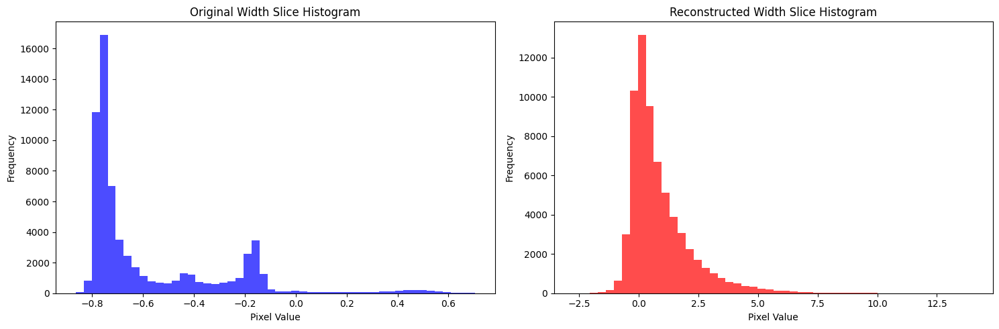

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=55` in the `DataLoader` to improve performance.
/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (18) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

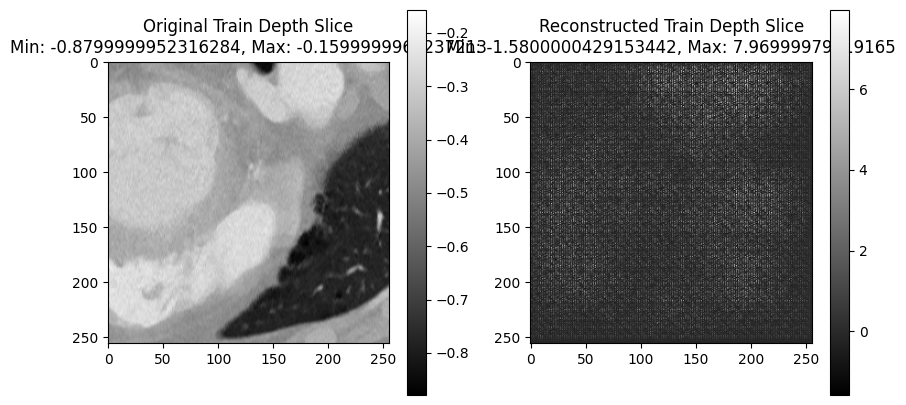

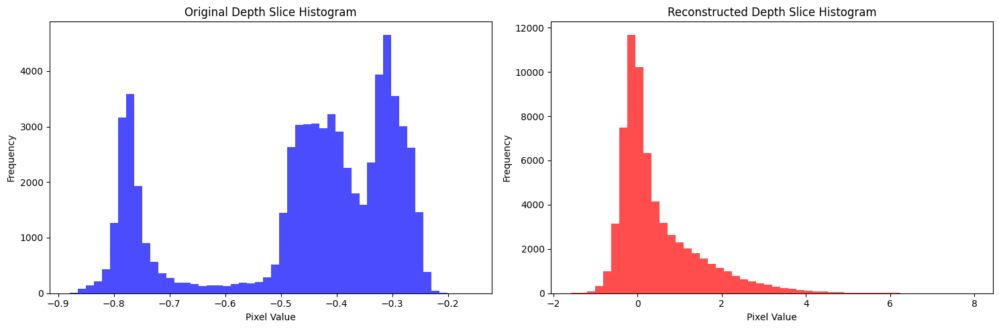

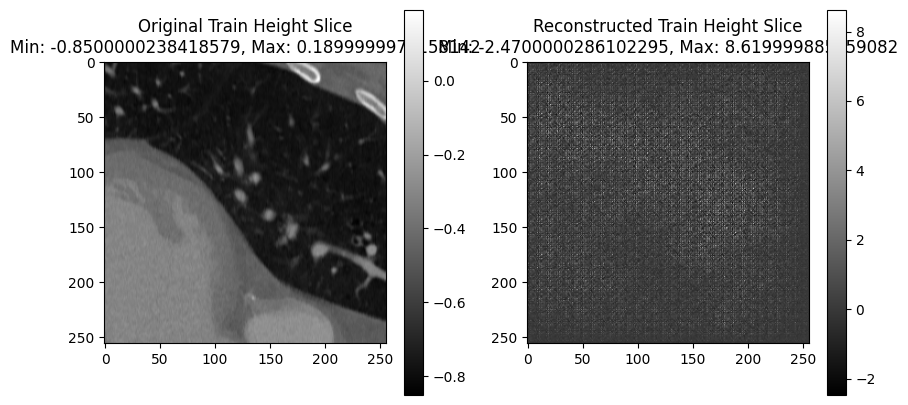

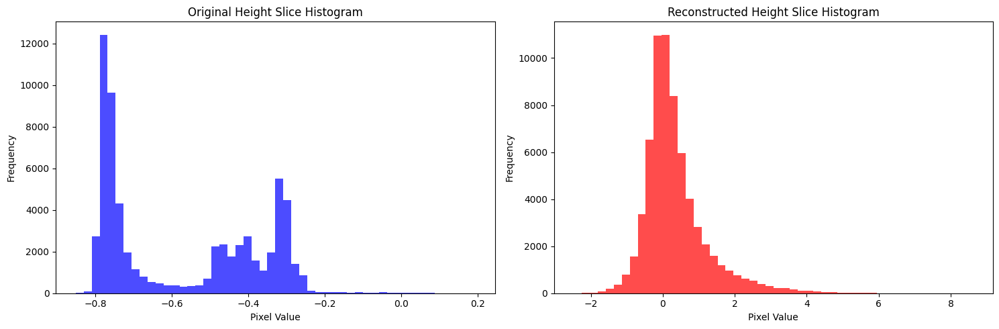

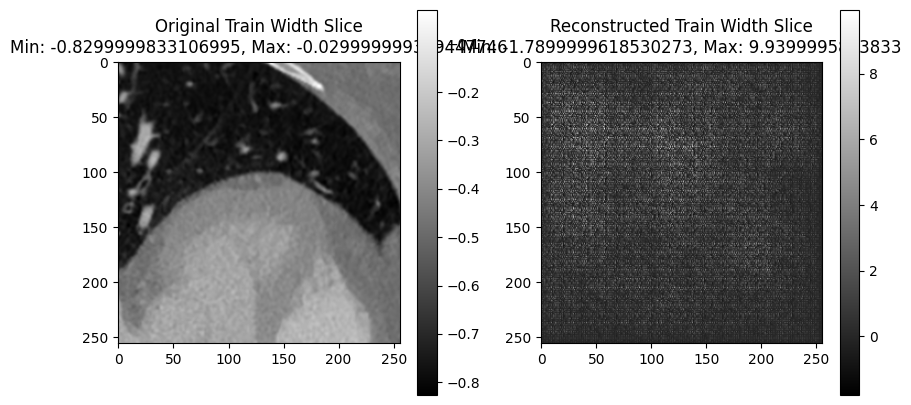

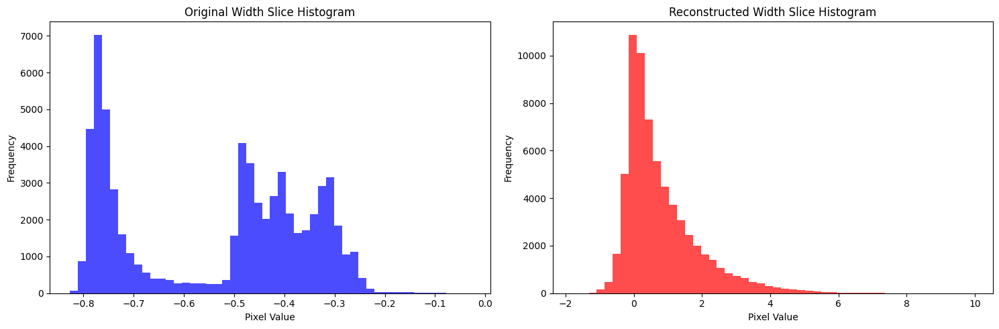

Validation: |          | 0/? [00:00<?, ?it/s]

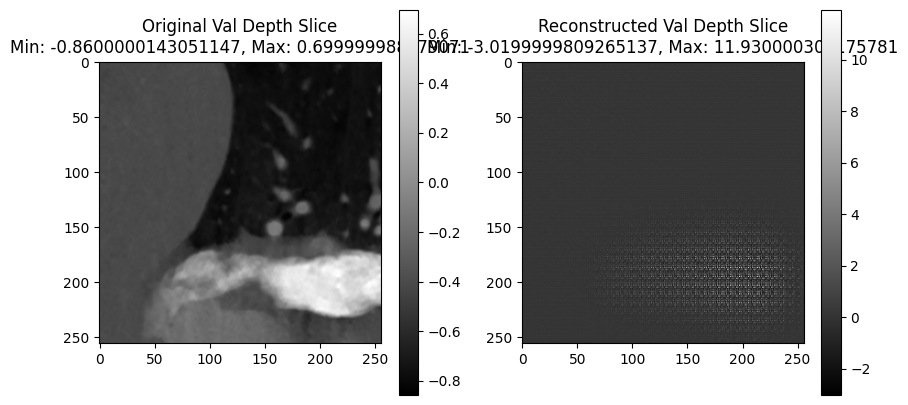

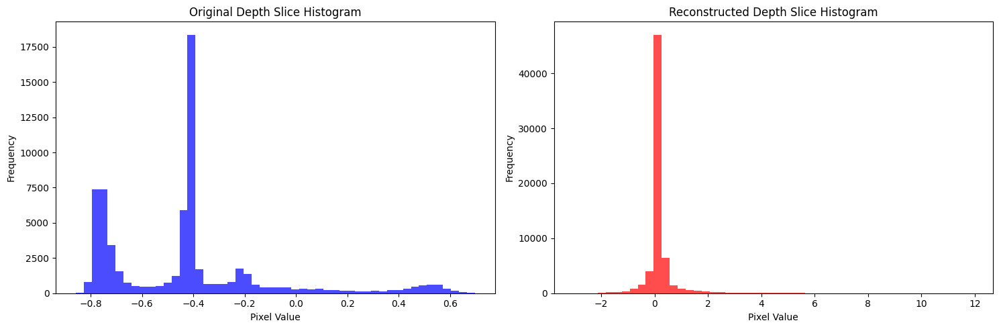

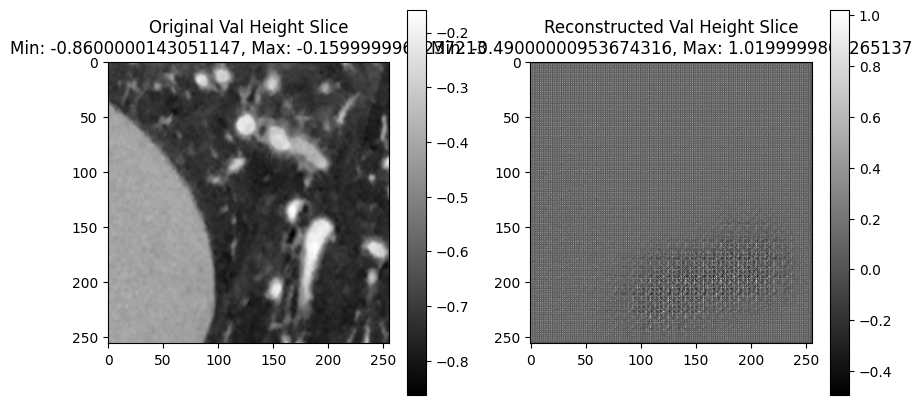

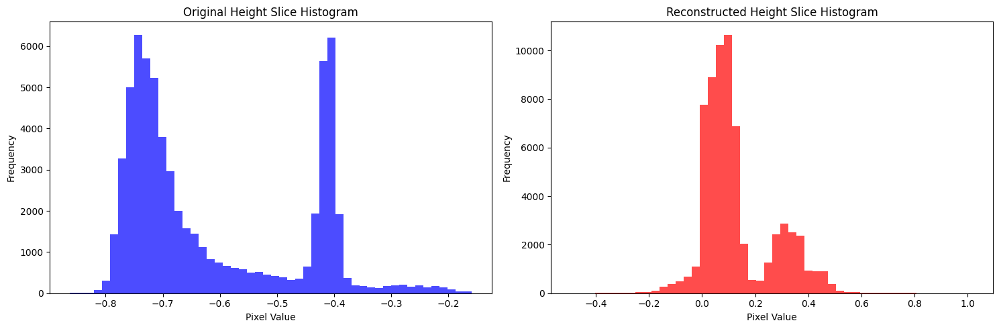

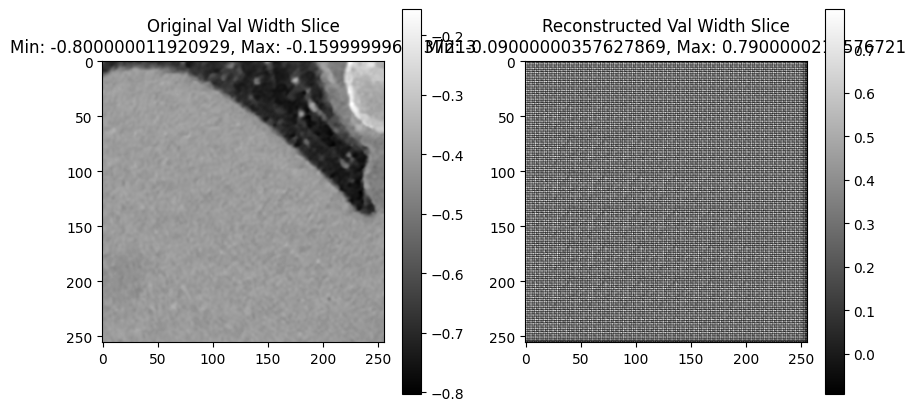

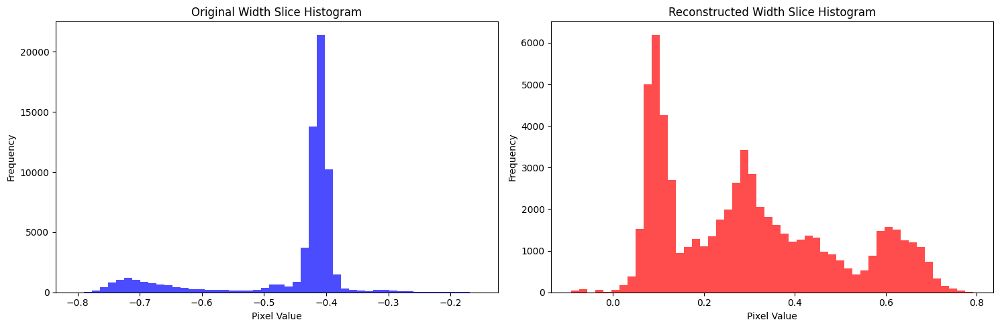

Time Spent 185.16
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 196.99
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 208.77
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 220.46
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 232.18
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 243.93
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 255.84
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 267.59
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 279.33
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 291.01
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 302.70
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 314.42
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 326.10
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 337.85
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 349.58
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 361.26
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 373.00
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 384.70
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 396.39
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 408.12
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 419.79
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 431.47
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 443.20
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 454.90
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 466.66
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 478.32
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 489.97
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 501.69
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 513.35
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 525.04
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 536.92
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 548.64
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 560.30
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 571.99
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 583.67
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 595.34
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 607.04
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 618.70
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 630.44
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 642.09
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 653.78
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 665.51
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 677.18
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 688.91
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 700.64
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 712.34
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 724.03
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 735.84
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 747.54
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 759.35
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 770.99
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 782.73
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 794.52
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 806.28
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 818.03
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 829.78
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 841.64
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 853.29
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 865.06
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 876.91
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 888.63
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 900.41
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 912.13
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 923.84
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 935.51
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 947.20
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 959.07
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 970.76
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 982.41
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 994.14
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1005.87
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1017.58
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1029.31
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1040.96
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1052.78
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1064.46
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1076.21
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1087.92
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1099.60
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1111.25
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1123.04
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1134.67
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1146.46
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1158.38
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1170.11
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1181.85
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1193.80
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1205.85
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1217.70
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1229.35
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1241.07
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1252.79
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1264.52
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1276.31
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1288.07
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1299.77
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1311.79
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1323.71
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1335.40
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1347.30
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1359.00
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1370.66
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1382.53
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1394.53
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1406.22
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1418.19
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1429.86
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1441.55
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1453.26
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1465.06
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1476.71
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1488.41
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1500.23
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1512.00
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1523.86
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1535.53
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1547.27
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1559.00
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1570.80
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1582.66
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1594.43
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1606.27
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1618.78
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1630.89
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1642.84
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1654.51
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1666.20
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1677.95
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1689.65
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1701.28
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1712.96
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1724.71
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1736.37
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1748.09
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1759.72
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1771.47
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1783.16
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1794.77
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1806.60
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1818.30
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1829.93
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1841.62
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1853.66
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1865.36
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1877.10
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1888.72
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1900.41
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1912.09
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1923.70
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1935.43
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1947.07
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1958.69
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1970.39
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1982.10
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1993.77
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2005.47
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2017.09
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2028.71
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2040.73
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2052.48
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2064.13
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2075.93
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2087.57
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2099.28
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2110.92
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2122.56
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2134.29
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2145.99
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2157.64
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2169.34
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2181.06
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2192.71
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2204.44
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2216.60
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2228.34
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2239.98
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2251.71
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2263.42
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2275.07
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2286.71
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2298.54
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2310.23
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2321.95
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2333.75
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2345.41
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2357.20
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2368.92
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2380.66
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2392.70
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2404.34
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2416.10
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2427.80
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2439.44
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2451.08
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2462.78
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2474.49
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2486.15
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2497.94
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2509.60
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2521.31
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2533.25
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2544.91
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2556.61
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2568.36
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2580.03
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2591.72
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2603.50
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2615.24
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2627.08
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2638.73
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2650.48
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2662.28
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2673.92
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2685.63
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2697.30
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2708.96
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2720.66
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2732.32
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2743.97
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2755.68
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2767.32
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2779.00
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2790.75
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2802.40
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2814.16
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2825.80
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2837.47
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2849.18
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2860.82
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2872.48
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2884.19
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2895.90
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2907.55
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2919.40
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2931.12
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2942.76
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2954.68
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2966.35
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2978.11
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2989.75
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3001.44
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3013.15
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3024.80
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3036.48
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3048.19
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3059.90
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3071.55
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3083.31
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3095.00
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3106.74
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3118.54
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3130.22
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3142.01
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3153.72
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3165.39
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3177.14
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3188.85
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3200.63
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3212.35
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3225.04
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3236.73
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3248.54
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3260.51
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3272.30
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3283.96
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3295.66
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3307.41
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3319.07
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3330.74
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3342.50
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3354.25
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3365.90
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3377.69
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3389.51
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3401.32
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3413.00
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3424.66
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3436.39
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3448.09
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3459.73
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3471.53
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3483.19
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3494.85
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3506.59
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3518.26
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3530.04
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3541.77
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3553.64
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3565.42
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3577.14
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3588.79
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3600.49
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3612.16
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3623.79
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3635.47
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3647.11
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3658.93
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3670.61
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3682.23
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3693.95
Epoch: 300


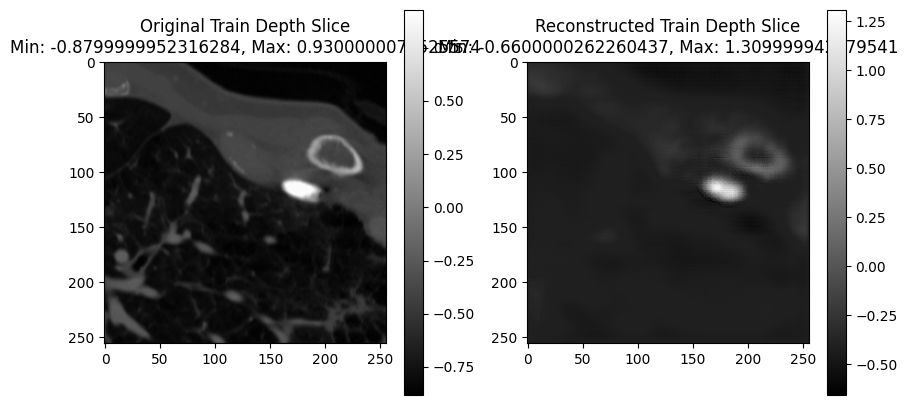

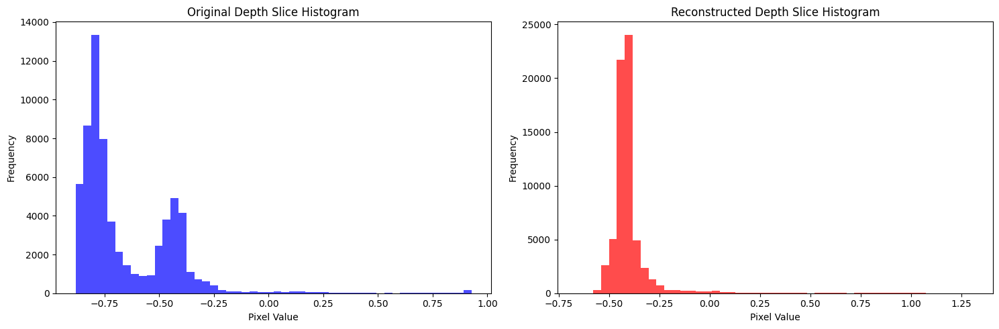

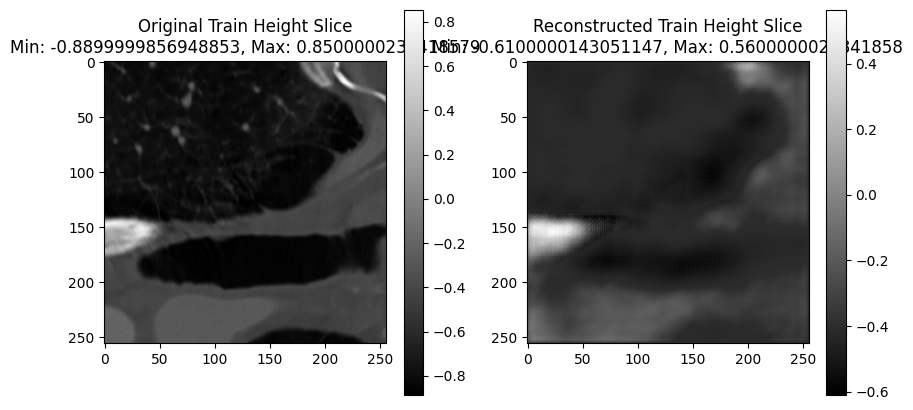

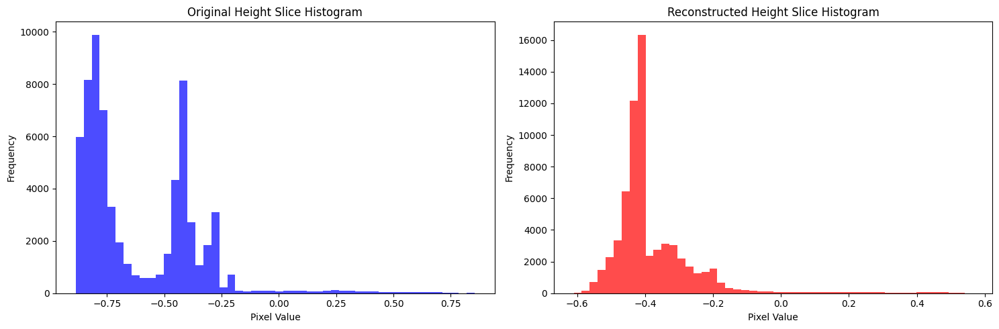

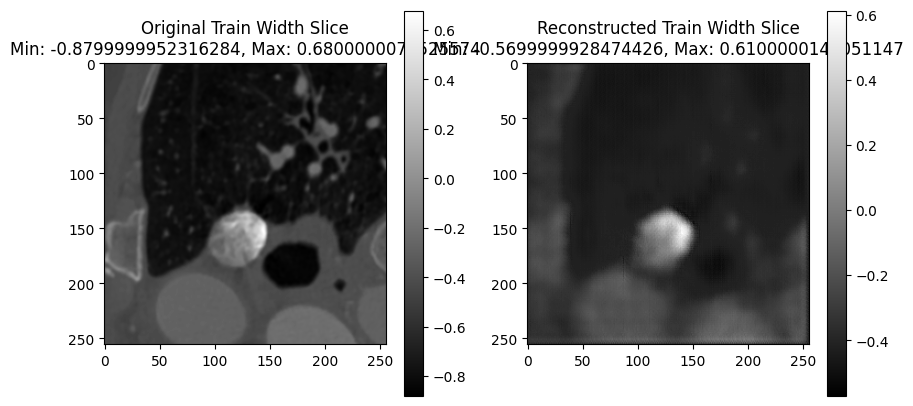

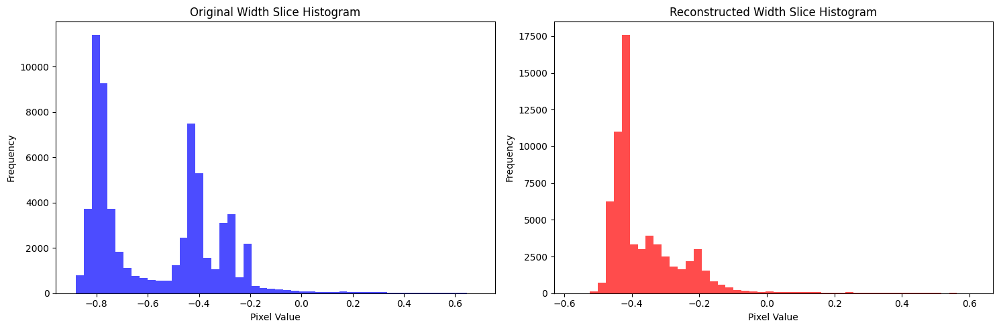

Validation: |          | 0/? [00:00<?, ?it/s]

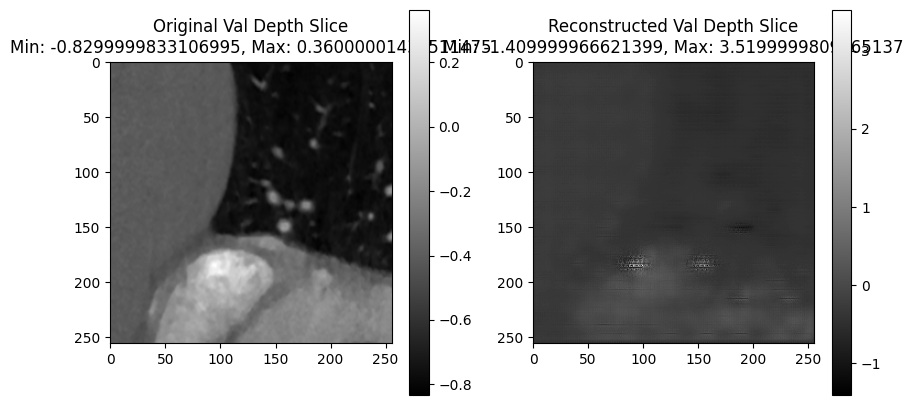

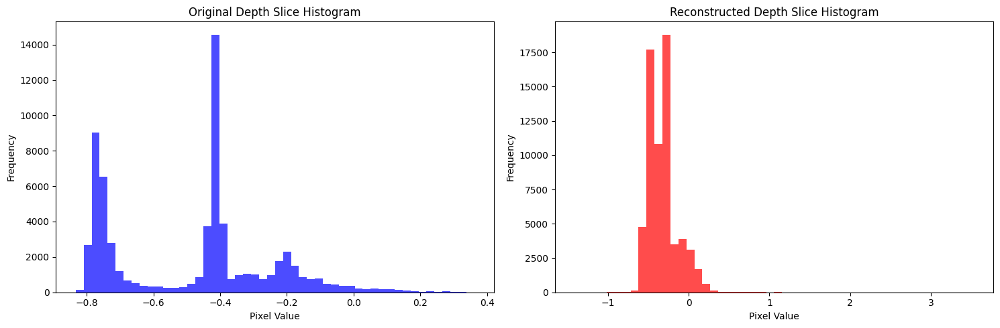

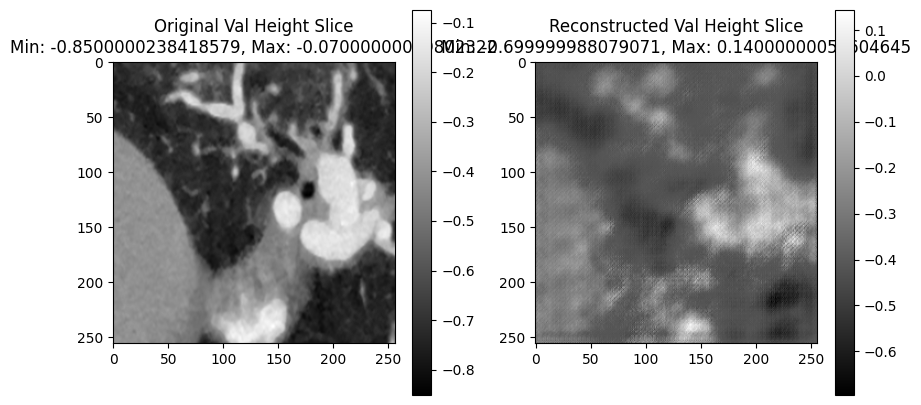

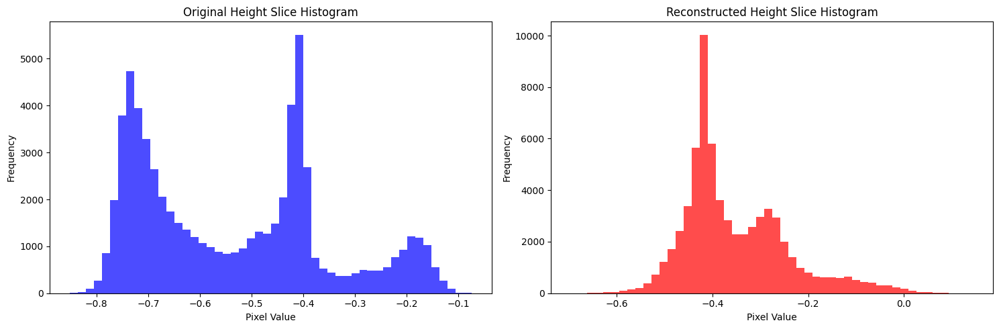

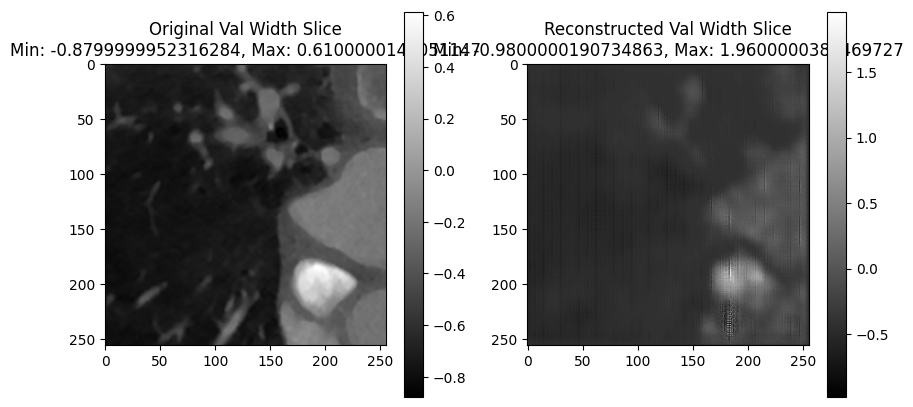

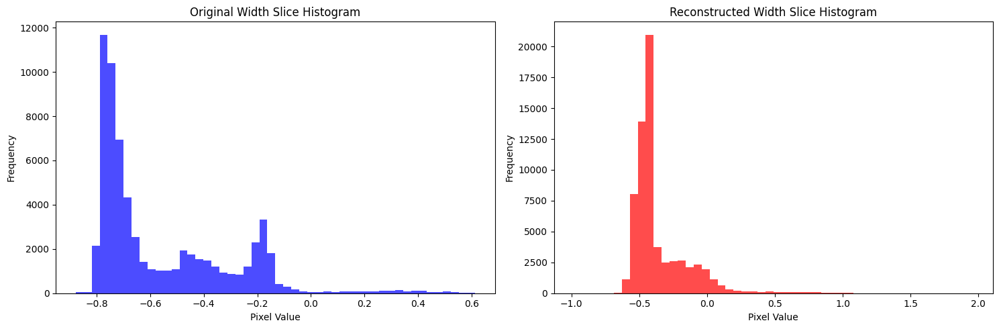

Time Spent 3712.14
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3723.79
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3735.46
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3747.08
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3758.73
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3770.45
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3782.08
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3793.76
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3805.52
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3817.17
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3828.81
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3840.53
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3852.17
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3863.91
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3875.55
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3887.19
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3898.89
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3910.60
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3922.25
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3933.96
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3945.84
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3957.50
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3969.23
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3980.88
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3992.58
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4004.24
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4015.89
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4027.59
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4039.23
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4050.91
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4062.61
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4074.25
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4085.90
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4097.61
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4109.25
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4120.90
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4132.60
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4144.28
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4156.01
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4167.71
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4179.35
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4191.16
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4202.78
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4214.45
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4226.23
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4238.04
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4249.73
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4261.56
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4273.21
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4284.93
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4296.68
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4308.32
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4320.12
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4331.78
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4343.52
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4355.22
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4366.87
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4378.54
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4390.23
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4401.90
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4413.70
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4425.53
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4437.19
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4448.92
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4460.55
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4472.27
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4484.01
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4495.67
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4507.35
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4519.06
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4530.71
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4542.37
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4554.24
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4565.94
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4577.69
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4589.37
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4601.11
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4612.87
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4624.70
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4636.33
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4648.08
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4659.73
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4671.41
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4683.18
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4694.83
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4706.52
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4718.23
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4729.89
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4741.66
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4753.32
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4765.09
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4776.81
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4788.63
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4800.31
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4812.01
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4823.66
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4835.38
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4847.18
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4858.98
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4870.73
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4882.70
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4894.36
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4906.11
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4917.79
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4929.74
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4941.48
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4953.14
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4964.80
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4976.52
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4988.23
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4999.91
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5011.68
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5023.37
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5035.13
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5046.83
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5058.50
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5070.24
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5081.91
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5093.60
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5105.31
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5117.07
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5128.79
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5140.70
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5152.38
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5164.13
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5175.92
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5187.59
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5199.33
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5211.02
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5222.71
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5234.51
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5246.21
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5257.95
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5269.68
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5281.36
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5293.05
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5304.76
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5316.44
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5328.17
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5339.84
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5351.60
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5363.39
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5375.10
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5386.78
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5398.69
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5410.60
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5422.51
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5434.40
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5446.28
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5458.08
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5469.79
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5481.60
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5493.36
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5505.05
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5516.74
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5528.48
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5540.13
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5551.78
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5563.48
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5575.16
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5586.84
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5598.56
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5610.21
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5621.91
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5633.62
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5645.30
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5657.02
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5668.72
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5680.41
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5692.14
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5703.86
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5715.59
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5727.29
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5738.94
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5750.65
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5762.29
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5773.94
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5785.63
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5797.29
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5808.93
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5820.63
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5832.32
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5843.97
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5855.68
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5867.32
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5879.05
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5890.75
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5902.48
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5914.26
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5925.91
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5937.55
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5949.27
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5961.07
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5972.70
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5984.46
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5996.10
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6007.74
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6019.48
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6031.16
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6042.93
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6054.67
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6066.52
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6079.16
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6090.86
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6102.84
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6114.88
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6126.73
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6138.42
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6150.18
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6161.88
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6173.53
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6185.33
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6197.07
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6208.81
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6220.56
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6232.48
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6244.67
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6256.49
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6268.37
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6280.19
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6291.83
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6303.69
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6315.53
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6327.21
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6338.91
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6350.59
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6362.23
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6373.93
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6385.58
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6397.23
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6408.98
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6420.64
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6432.35
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6444.06
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6455.73
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6467.37
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6479.09
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6490.72
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6502.75
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6514.38
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6526.12
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6537.83
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6549.48
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6561.27
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6572.97
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6584.67
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6596.41
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6608.16
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6619.79
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6631.50
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6643.15
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6654.82
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6666.63
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6678.29
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6689.97
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6701.67
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6713.31
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6724.96
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6736.66
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6748.30
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6759.94
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6771.62
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6783.25
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6794.95
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6806.58
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6818.23
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6830.05
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6841.70
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6853.34
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6865.08
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6876.79
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6888.54
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6900.31
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6911.97
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6923.69
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6935.36
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6947.07
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6958.80
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6970.46
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6982.12
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6993.84
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7005.49
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7017.13
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7028.85
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7040.53
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7052.21
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7063.92
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7075.69
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7087.38
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7099.01
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7110.71
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7122.44
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7134.15
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7145.80
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7157.49
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7169.15
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7180.84
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7192.79
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7204.52
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7216.27
Epoch: 600


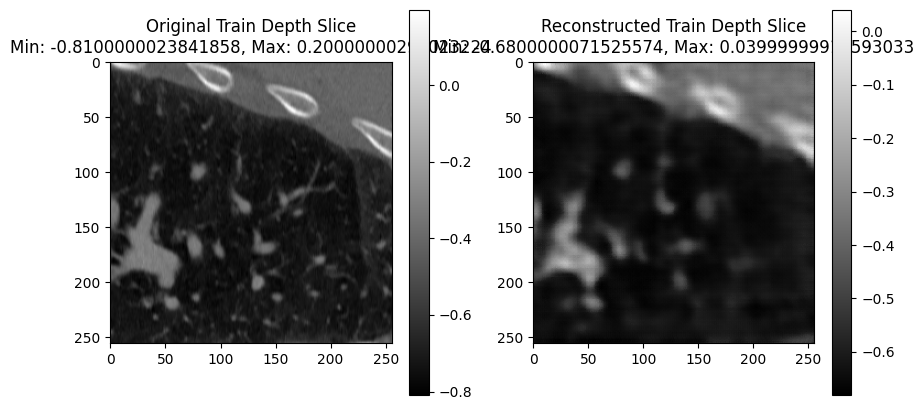

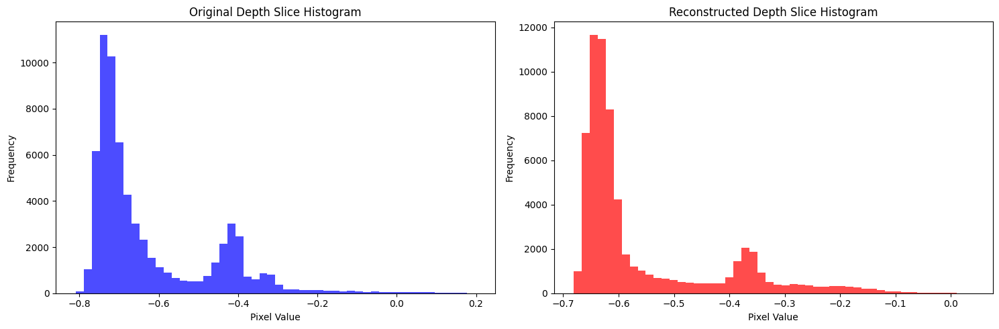

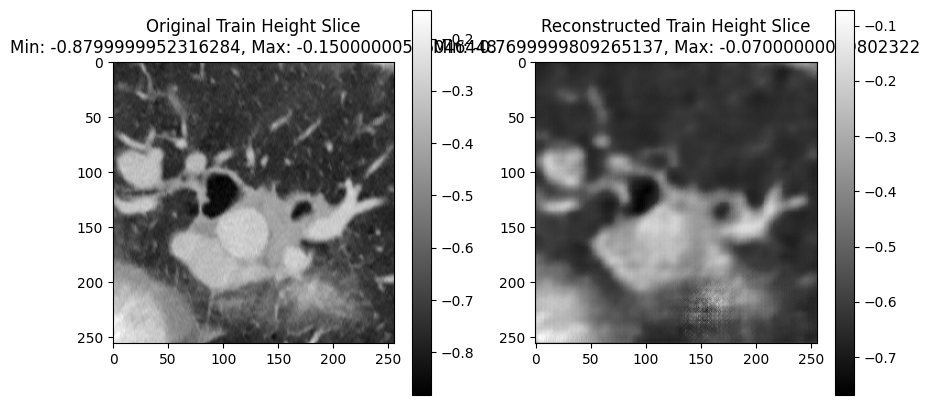

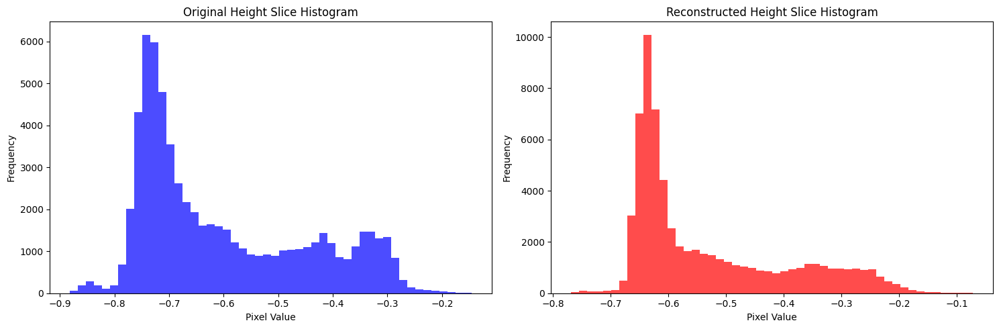

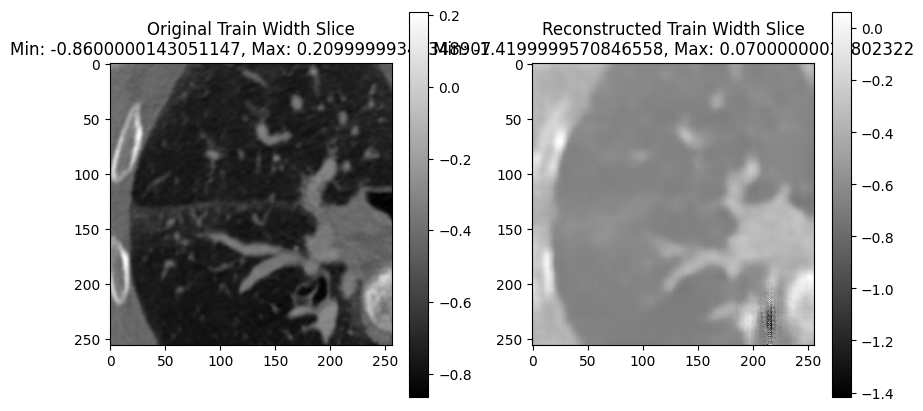

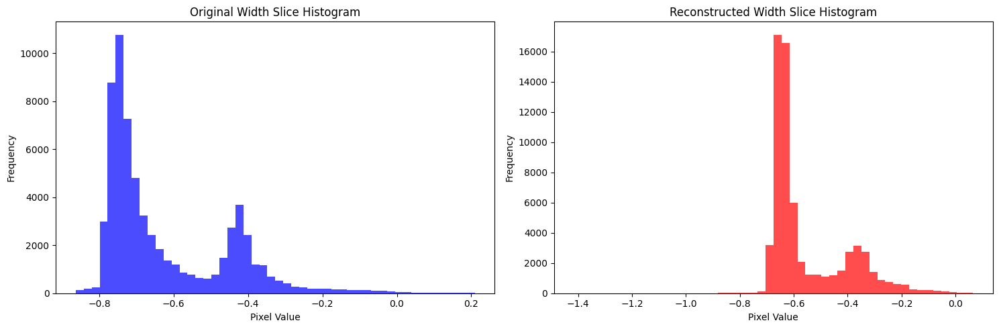

Validation: |          | 0/? [00:00<?, ?it/s]

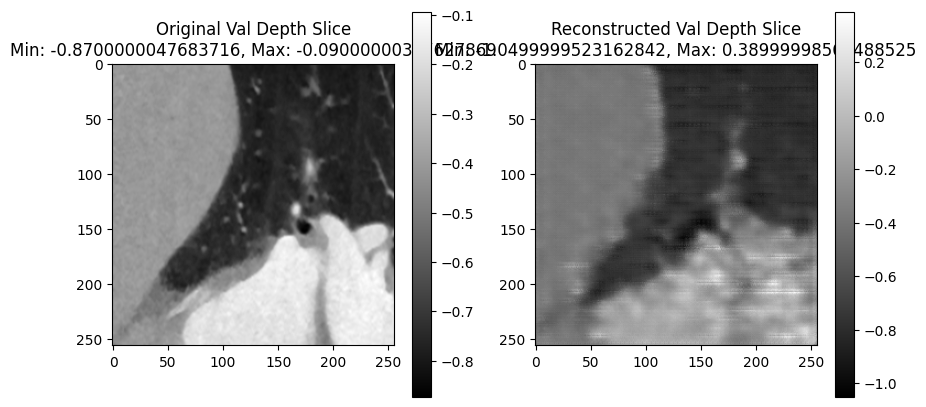

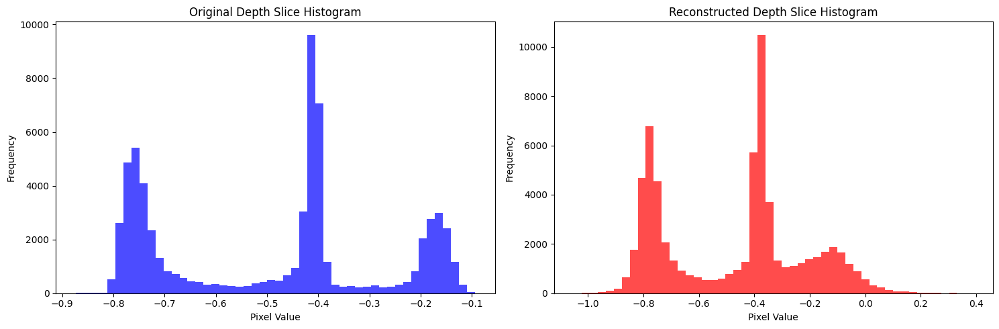

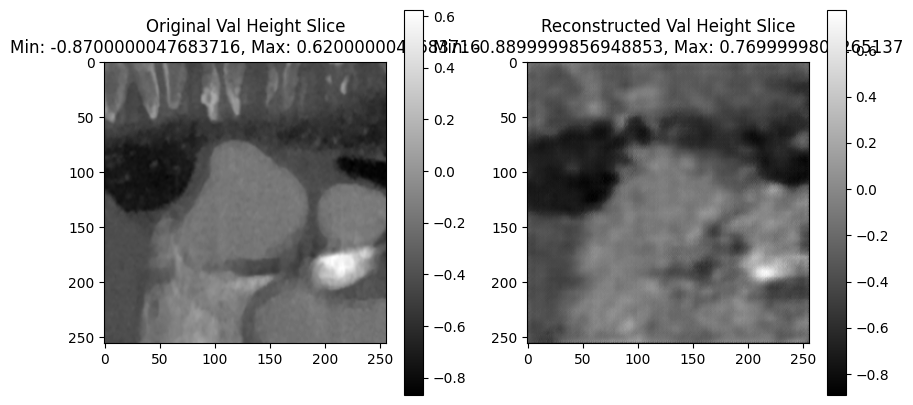

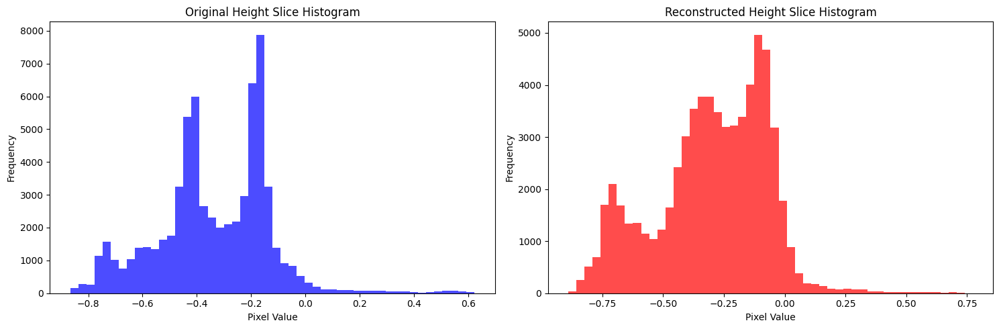

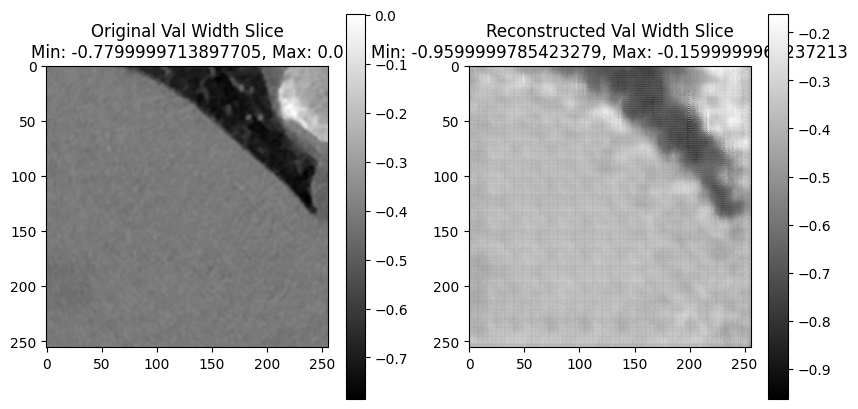

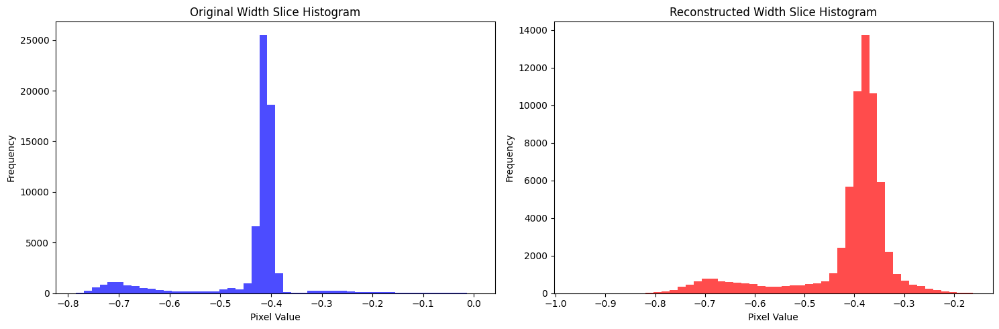

Time Spent 7235.29
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7246.94
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7258.72
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7270.45
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7282.12
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7293.96
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7305.65
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7317.31
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7329.06
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7340.70
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7352.34
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7364.11
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7375.76
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7387.56
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7399.22
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7410.87
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7422.66
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7434.30
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7445.96
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7457.75
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7469.45
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7481.13
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7492.85
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7504.63
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7516.36
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7528.04
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7539.70
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7551.51
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7563.22
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7574.89
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7586.70
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7598.48
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7610.17
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7621.87
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7633.69
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7645.42
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7657.12
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7668.75
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7680.50
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7692.25
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7704.29
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7716.08
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7727.71
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7739.37
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7751.25
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7762.93
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7774.60
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7786.32
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7798.02
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7809.81
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7821.65
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7833.29
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7845.06
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7856.83
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7869.58
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7881.66
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7893.48
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7905.13
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7916.87
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7928.51
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7940.15
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7951.90
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7963.54
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7975.25
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7986.93
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7998.62
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8010.43
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8022.13
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8033.81
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8045.55
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8057.45
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8069.14
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8080.87
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8092.59
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8104.35
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8116.23
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8127.94
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8139.93
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8151.62
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8163.41
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8175.16
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8186.87
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8198.54
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8210.29
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8221.95
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8233.61
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8245.35
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8257.00
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8268.74
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8280.58
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8292.30
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8304.06
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8315.74
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8327.48
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8339.23
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8350.94
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8362.64
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8374.39
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8386.06
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8397.82
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8409.48
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8421.14
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8432.87
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8444.55
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8456.25
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8467.96
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8479.76
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8491.55
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8503.35
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8514.99
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8526.69
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8538.44
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8550.08
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8561.83
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8573.48
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8585.16
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8596.85
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8608.51
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8620.15
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8631.85
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8643.51
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8655.23
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8666.96
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8678.59
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8690.38
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8703.70
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8715.35
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8727.10
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8738.77
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8750.44
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8762.15
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8773.80
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8785.63
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8797.52
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8809.35
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8821.01
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8832.73
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8844.49
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8856.30
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8868.10
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8879.85
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8891.66
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8903.31
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8914.95
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8926.65
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8938.39
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8950.04
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8961.83
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8973.48
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8985.20
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8996.97
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9008.62
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9020.37
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9032.10
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9043.73
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9055.53
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9067.38
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9079.17
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9090.87
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9102.51
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9114.24
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9126.00
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9137.67
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9149.43
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9161.26
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9173.19
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9184.89
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9196.66
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9208.30
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9220.07
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9231.77
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9243.41
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9255.12
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9266.75
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9278.46
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9290.10
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9301.75
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9313.46
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9325.10
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9336.75
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9348.58
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9360.22
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9371.87
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9383.58
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9395.25
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9406.92
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9418.82
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9430.58
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9442.36
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9454.10
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9465.78
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9477.72
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9489.48
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9501.20
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9512.94
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9524.62
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9536.29
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9548.03
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9559.70
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9571.46
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9583.44
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9595.09
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9606.90
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9618.58
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9630.27
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9641.99
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9653.70
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9665.42
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9677.30
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9689.09
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9700.75
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9712.48
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9724.14
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9735.90
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9747.54
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9759.18
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9770.90
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9782.60
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9794.29
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9806.06
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9817.72
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9829.37
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9841.13
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9852.92
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9864.76
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9876.40
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9888.05
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9899.80
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9911.58
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9923.27
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9935.03
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9946.70
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9958.36
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9970.09
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9981.78
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9993.47
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10005.20
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10016.89
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10028.69
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10040.36
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10052.03
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10063.78
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10075.45
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10087.12
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10098.86
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10110.52
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10122.21
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10133.95
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10145.66
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10157.43
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10169.12
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10180.79
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10192.54
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10204.20
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10215.91
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10227.75
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10239.41
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10251.11
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10262.88
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10274.60
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10286.26
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10298.02
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10309.70
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10321.43
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10333.10
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10344.78
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10356.53
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10368.20
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10379.86
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10391.63
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10403.28
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10414.95
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10426.78
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10438.45
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10450.24
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10461.92
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10473.71
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10485.63
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10497.33
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10509.03
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10520.76
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10532.49
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10544.17
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10555.98
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10567.69
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10579.48
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10591.55
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10603.26
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10614.99
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10626.66
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10638.34
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10650.06
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10661.74
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10673.41
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10685.18
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10696.86
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10708.57
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10720.41
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10732.08
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10743.87
Epoch: 900


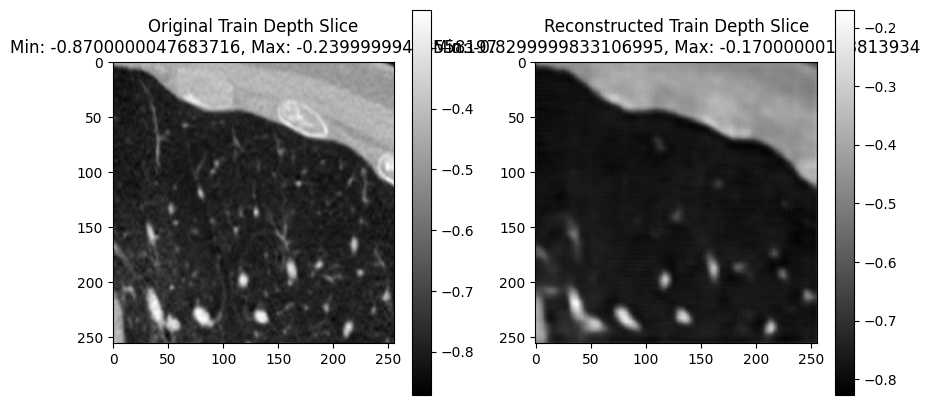

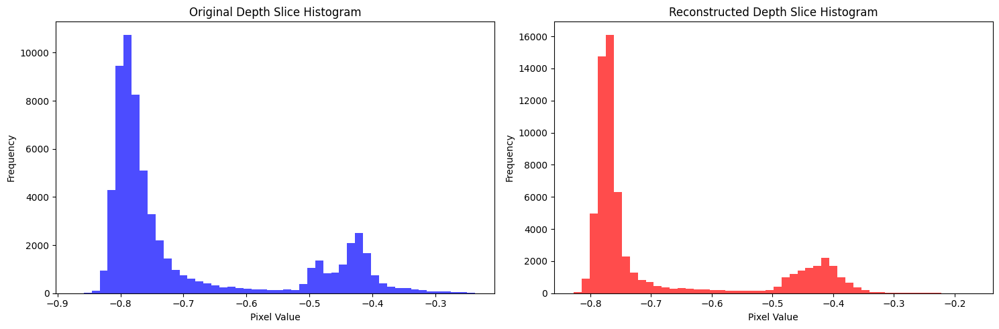

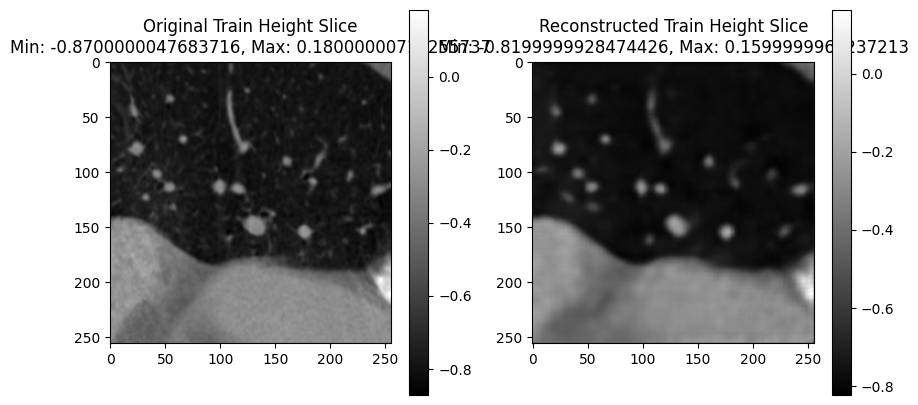

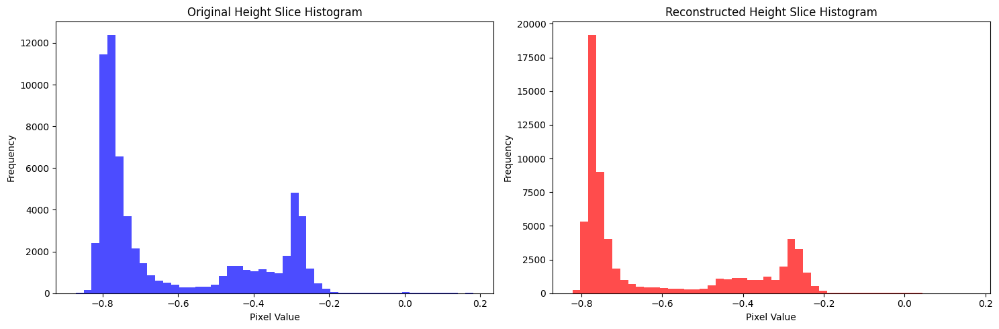

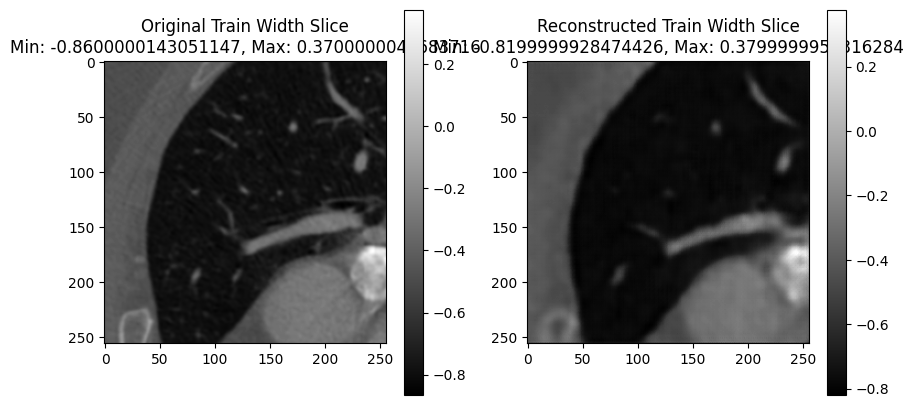

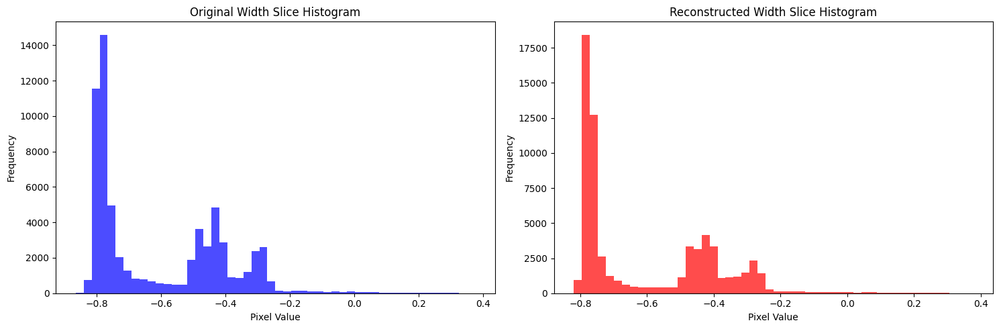

Validation: |          | 0/? [00:00<?, ?it/s]

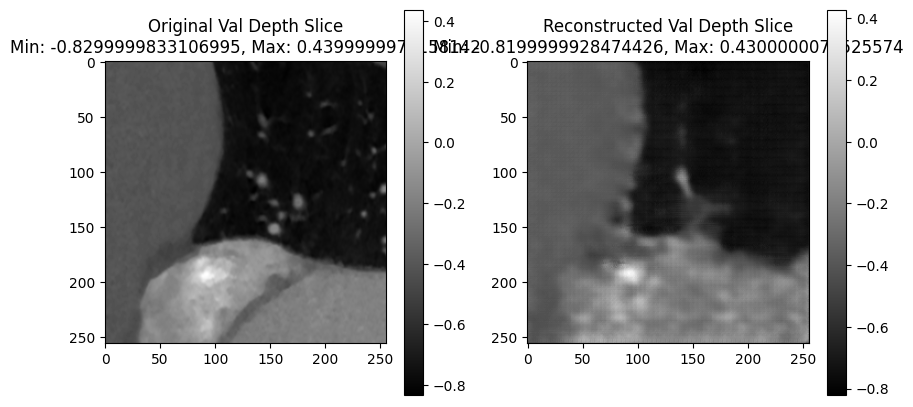

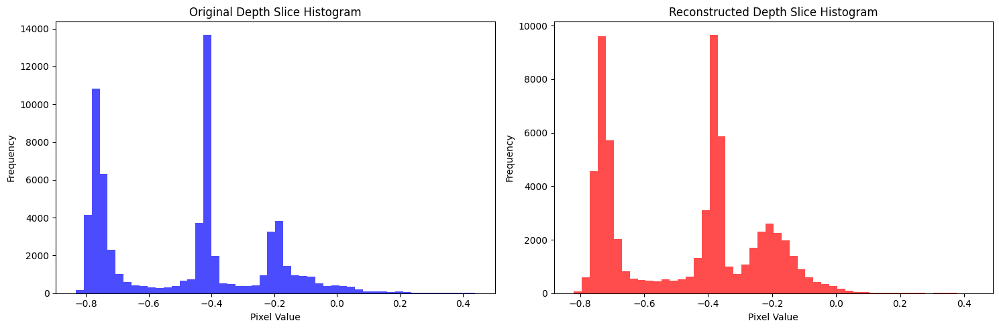

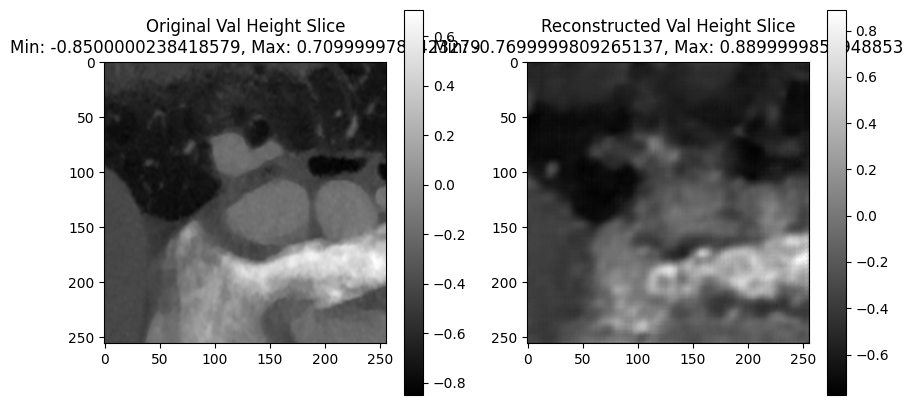

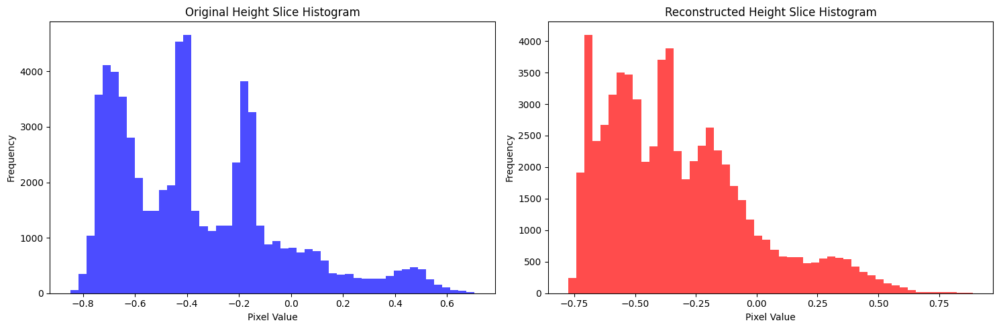

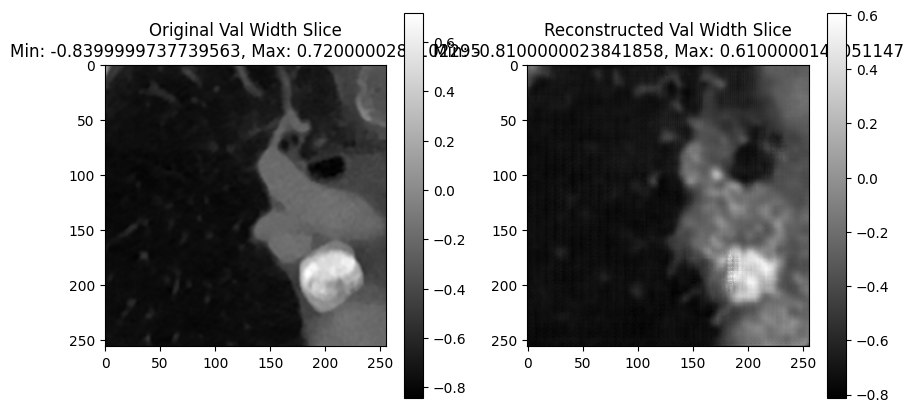

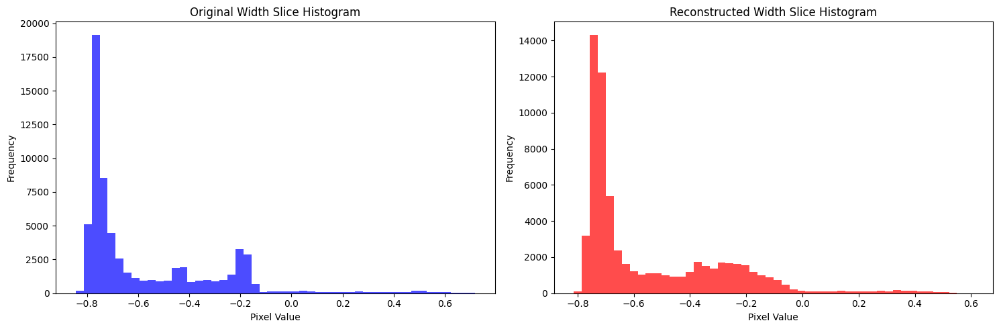

Time Spent 10763.98
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10775.64
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10787.38
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10799.05
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10810.71
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10822.44
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10834.12
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10845.77
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10857.57
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10869.25
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10881.06
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10892.82
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10904.53
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10916.24
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10927.90
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10939.56
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10951.26
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10962.92
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10974.63
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10986.35
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10998.01
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11009.67
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11021.39
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11033.07
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11044.81
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11056.48
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11068.16
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11079.88
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11091.72
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11103.39
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11115.13
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11126.77
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11138.44
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11150.17
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11161.86
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11173.75
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11185.48
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11197.20
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11208.93
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11220.72
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11232.38
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11244.14
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11255.84
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11267.54
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11279.31
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11291.07
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11302.90
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11314.73
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11326.58
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11338.45
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11350.13
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11361.81
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11373.59
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11385.27
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11396.98
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11408.72
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11420.38
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11432.11
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11443.96
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11455.65
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11467.33
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11479.15
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11490.88
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11502.64
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11514.32
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11526.03
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11537.86
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11549.56
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11561.24
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11573.02
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11584.74
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11596.48
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11608.19
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11619.85
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11631.60
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11643.28
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11655.00
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11666.85
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11678.57
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11690.24
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11701.98
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11713.65
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11725.33
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11737.14
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11748.89
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11760.67
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11772.41
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11784.08
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11795.80
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11807.47
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11819.13
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11830.96
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11842.66
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11854.41
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11866.12
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11877.78
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11889.44
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11901.18
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11912.84
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11924.60
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11936.58
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11948.26
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11960.02
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11971.69
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11983.36
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11995.10
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12006.82
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12018.57
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12030.38
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12042.03
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12053.91
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12065.95
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12077.64
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12089.36
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12101.06
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12112.80
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12124.58
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12136.27
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12147.90
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12159.70
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12171.33
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12182.97
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12194.67
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12206.30
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12218.01
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12229.65
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12241.29
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12253.00
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12264.70
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12276.46
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12288.22
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12299.90
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12311.55
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12323.28
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12334.93
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12346.73
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12358.45
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12370.09
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12381.92
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12393.56
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12405.20
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12416.90
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12428.54
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12440.20
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12451.94
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12463.64
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12475.34
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12487.06
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12498.71
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12510.49
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12522.17
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12533.78
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12545.46
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12557.16
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12568.80
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12580.67
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12592.30
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12603.93
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12615.68
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12627.35
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12638.99
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12650.83
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12662.47
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12674.19
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12685.84
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12697.52
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12709.23
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12720.95
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12732.66
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12744.45
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12756.14
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12767.84
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12779.59
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12791.25
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12803.00
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12814.73
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12826.41
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12838.15
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12849.83
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12861.50
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12873.26
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12884.94
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12896.61
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12908.38
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12920.08
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12931.77
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12943.54
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12955.21
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12966.95
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12978.70
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12990.41
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13002.14
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13013.80
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13025.48
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13037.22
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13048.90
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13060.57
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13072.30
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13084.04
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13095.84
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13107.58
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13119.26
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13131.01
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13142.68
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13154.38
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13166.13
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13177.85
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13189.66
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13201.41
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13213.12
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13224.78
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13236.56
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13248.22
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13260.01
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13271.72
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13283.43
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13295.17
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13306.82
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13318.45
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13330.21
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13341.90
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13353.59
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13365.33
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13377.08
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13388.83
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13400.50
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13412.20
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13423.92
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13435.69
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13447.33
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13459.06
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13470.73
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13482.38
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13494.19
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13506.15
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13517.80
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13529.52
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13541.21
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13552.91
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13564.55
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13576.20
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13587.90
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13599.53
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13611.19
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13622.95
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13634.63
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13646.32
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13658.02
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13669.67
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13681.53
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13693.24
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13704.89
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13716.59
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13728.26
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13739.89
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13751.59
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13763.30
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13775.07
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13786.86
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13798.57
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13810.22
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13822.08
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13833.77
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13845.55
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13857.21
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13868.86
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13880.62
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13892.27
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13903.91
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13915.63
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13927.33
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13938.97
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13951.15
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13962.91
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13974.80
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13986.72
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13998.41
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14010.21
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14021.96
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14033.60
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14045.29
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14056.94
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14068.70
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14080.42
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14092.08
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14103.73
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14115.54
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14127.22
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14138.96
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14150.61
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14162.37
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14174.09
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14185.76
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14197.52
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14209.20
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14221.02
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14232.78
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14244.55
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14256.34
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14268.17
Epoch: 1200


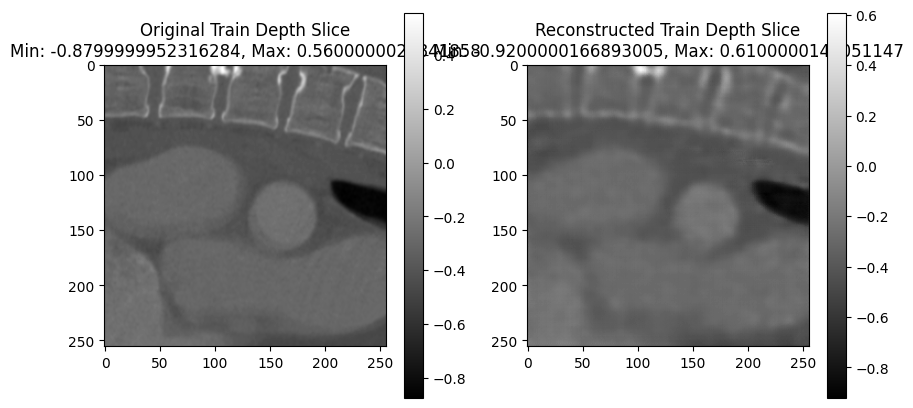

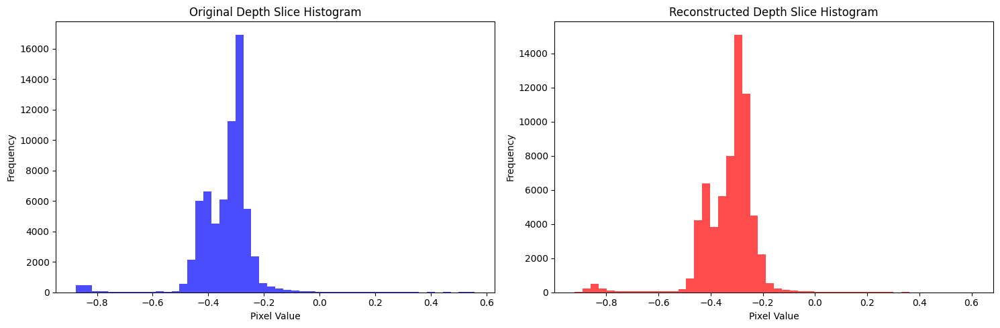

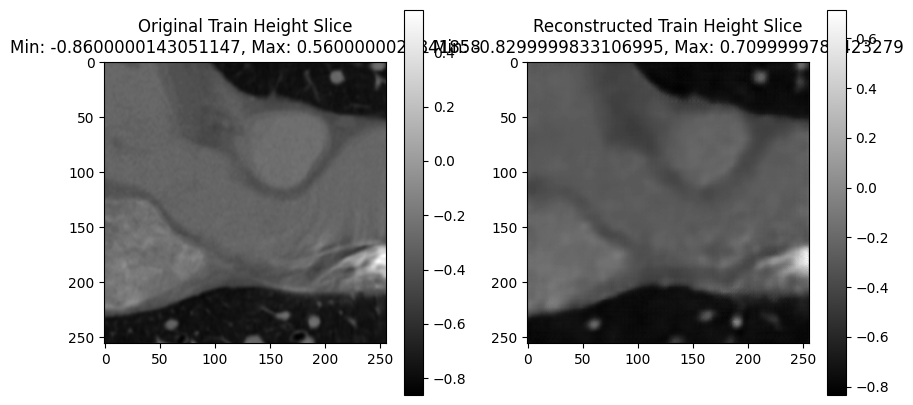

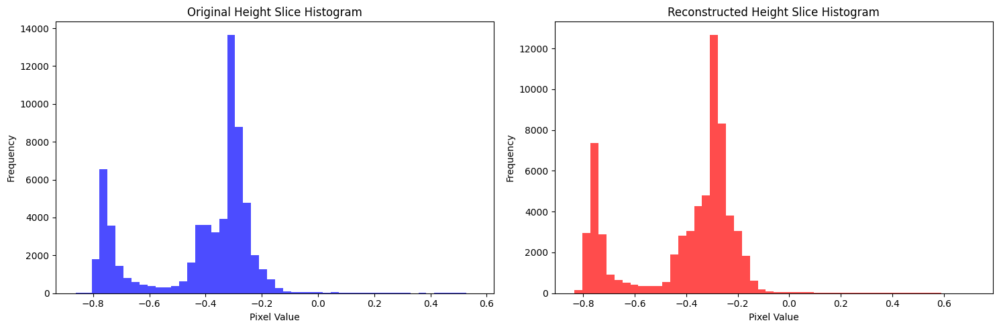

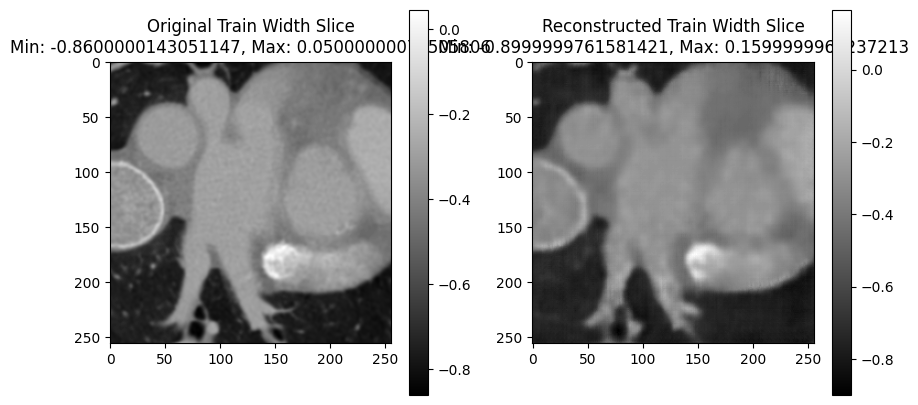

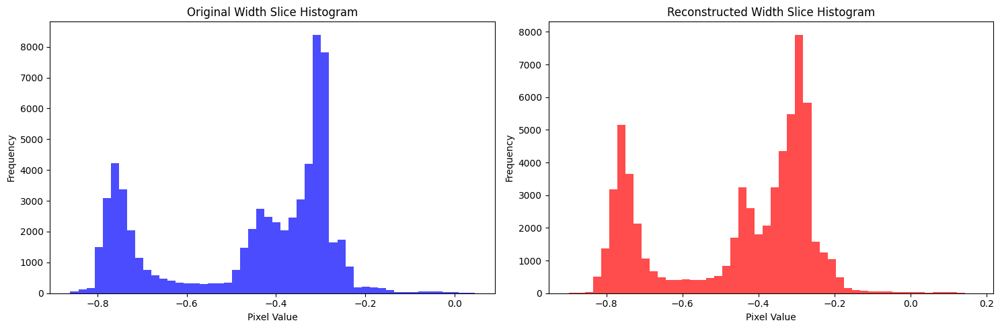

Validation: |          | 0/? [00:00<?, ?it/s]

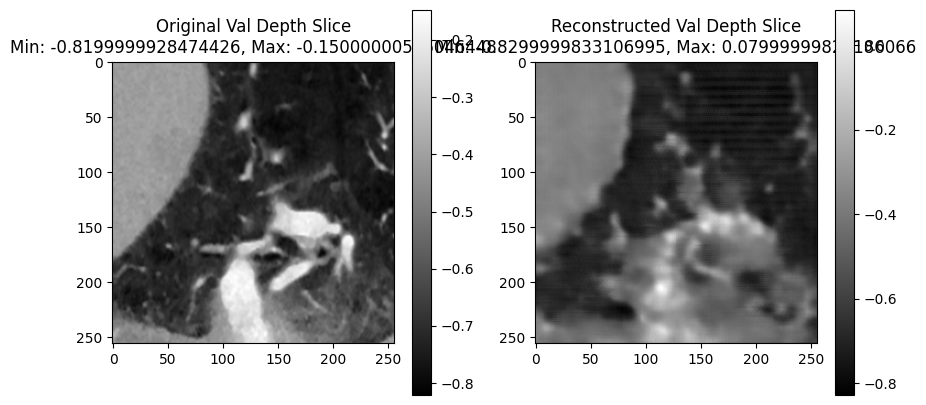

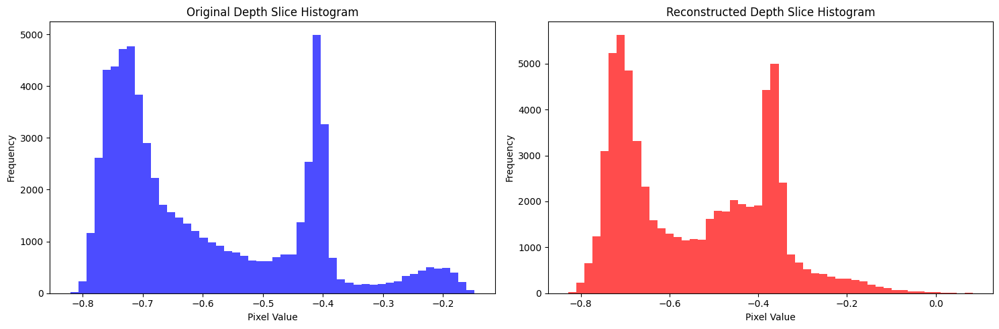

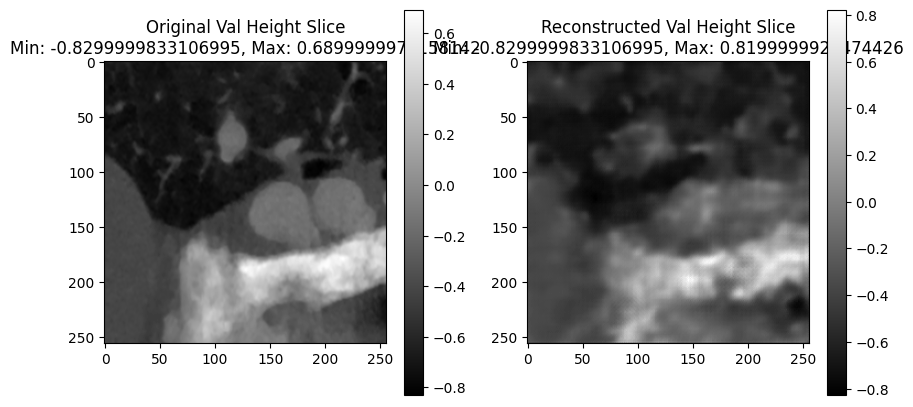

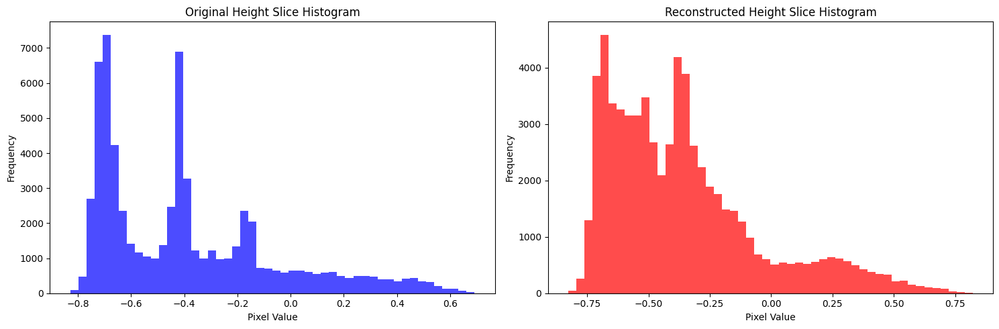

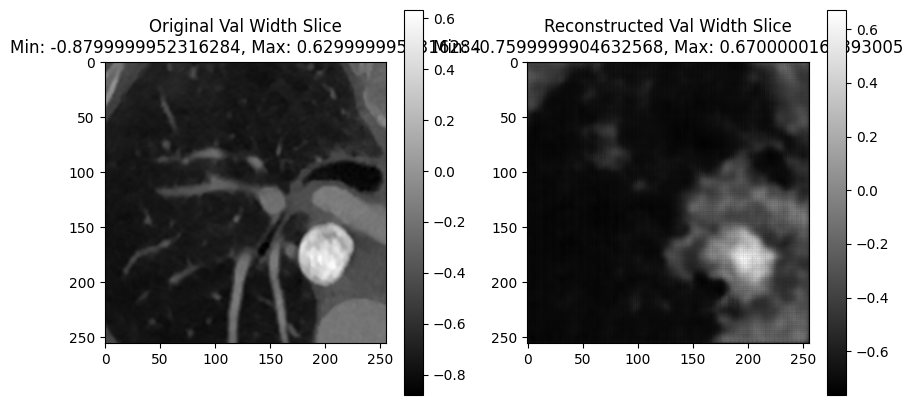

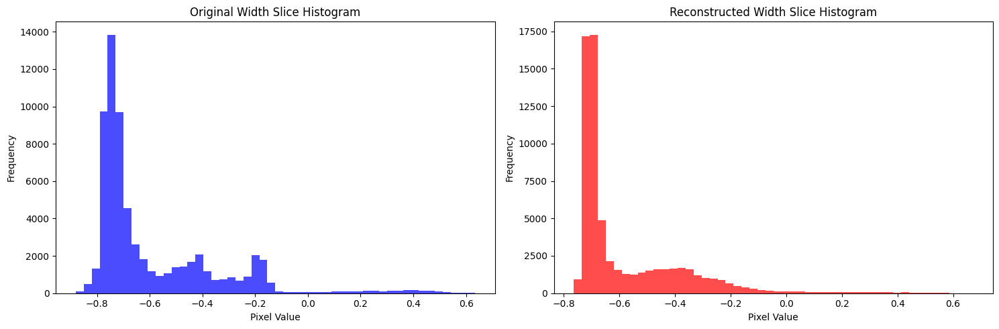

Time Spent 14286.63
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14298.27
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14309.96
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14321.70
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14333.45
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14345.13
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14356.77
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14368.51
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14380.20
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14391.85
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14403.60
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14415.34
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14426.98
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14438.83
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14450.47
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14462.14
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14473.84
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14485.52
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14497.16
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14508.85
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14520.52
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14532.22
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14543.91
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14555.54
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14567.29
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14578.97
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14591.09
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14602.78
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14614.44
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14626.08
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14637.84
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14649.65
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14661.45
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14673.13
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14684.76
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14696.43
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14708.15
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14719.92
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14731.62
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14743.25
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14754.89
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14766.59
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14778.23
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14789.87
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14801.64
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14813.29
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14824.98
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14836.70
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14848.34
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14860.09
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14871.84
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14883.50
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14895.20
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14906.83
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14918.48
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14930.18
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14941.85
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14953.52
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14965.33
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14976.97
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14988.63
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15000.37
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15012.05
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15023.77
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15035.55
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15047.23
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15058.97
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15070.64
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15082.26
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15093.94
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15105.59
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15117.28
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15129.00
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15140.63
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15152.34
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15164.01
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15175.70
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15187.47
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15199.19
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15210.89
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15222.66
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15234.35
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15245.98
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15257.76
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15269.43
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15281.28
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15293.04
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15304.71
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15316.48
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15328.19
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15339.85
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15351.58
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15363.25
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15374.92
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15386.69
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15398.37
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15410.06
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15421.79
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15433.46
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15445.20
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15456.88
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15468.53
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15480.26
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15491.93
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15503.59
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15515.34
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15527.02
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15538.70
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15550.46
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15562.15
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15573.90
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15585.63
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15597.30
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15609.06
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15620.75
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15632.42
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15644.16
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15655.82
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15667.54
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15679.27
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15690.98
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15702.67
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15714.39
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15726.08
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15737.84
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15749.55
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15761.23
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15773.00
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15784.66
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15796.34
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15808.08
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15819.76
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15831.44
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15843.19
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15854.86
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15866.89
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15878.80
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15890.50
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15902.34
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15914.03
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15925.72
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15937.51
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15949.20
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15960.88
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15972.69
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15984.35
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15996.03
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16007.79
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16019.46
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16031.24
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16042.92
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16054.63
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16066.37
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16078.11
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16089.83
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16101.63
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16113.27
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16125.03
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16136.75
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16148.51
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16160.25
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16171.96
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16183.61
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16195.30
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16206.97
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16218.62
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16230.36
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16242.00
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16253.65
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16265.37
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16277.02
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16288.66
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16300.38
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16312.02
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16323.85
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16335.68
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16347.30
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16359.01
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16370.66
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16382.29
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16394.24
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16405.92
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16417.56
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16429.26
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16440.89
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16452.52
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16464.31
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16475.94
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16487.62
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16499.24
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16510.85
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16522.54
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16534.21
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16545.84
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16557.63
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16569.32
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16580.97
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16592.83
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16604.68
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16616.45
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16628.43
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16640.08
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16651.88
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16663.58
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16675.21
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16686.92
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16698.57
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16710.29
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16722.00
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16733.63
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16745.28
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16757.04
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16768.68
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16780.42
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16792.06
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16803.74
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16815.49
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16827.15
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16838.81
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16850.64
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16862.35
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16874.02
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16885.72
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16897.38
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16909.10
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16920.79
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16932.41
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16944.16
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16955.80
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16967.46
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16979.18
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16990.81
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17002.51
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17014.26
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17025.95
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17037.67
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17049.44
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17061.27
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17072.97
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17084.63
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17096.30
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17108.05
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17119.70
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17131.44
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17143.17
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17154.92
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17166.63
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17178.36
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17190.02
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17201.86
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17213.60
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17225.28
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17237.03
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17248.78
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17260.52
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17272.33
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17283.99
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17295.63
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17307.33
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17318.97
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17330.61
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17342.31
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17353.98
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17365.73
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17377.45
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17389.11
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17400.87
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17412.55
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17424.24
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17435.98
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17447.64
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17459.30
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17471.03
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17482.71
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17494.45
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17506.10
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17517.76
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17529.49
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17541.14
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17552.79
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17564.52
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17576.20
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17587.87
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17599.72
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17611.46
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17623.15
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17634.90
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17646.59
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17658.31
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17669.98
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17681.65
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17693.38
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17705.04
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17716.72
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17728.45
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17740.15
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17751.82
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17763.55
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17775.21
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17786.97
Epoch: 1500


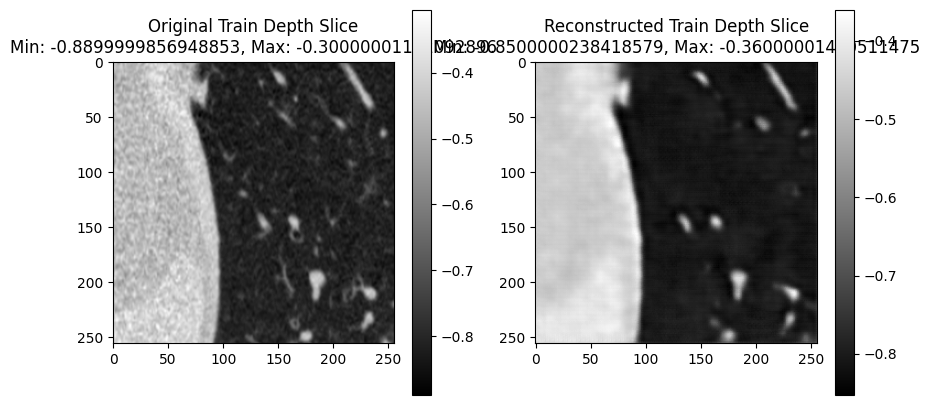

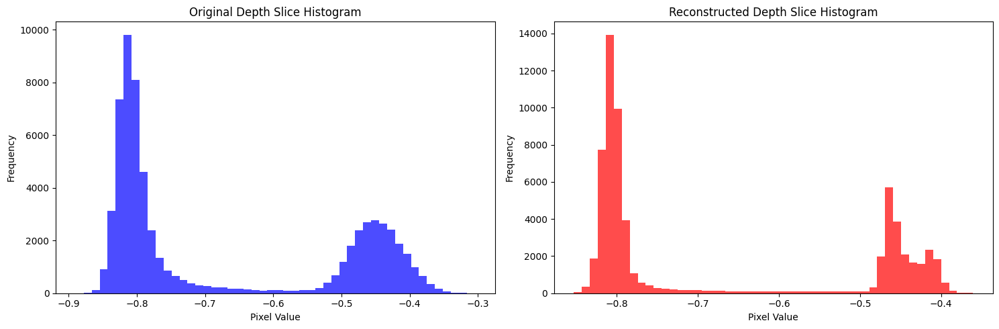

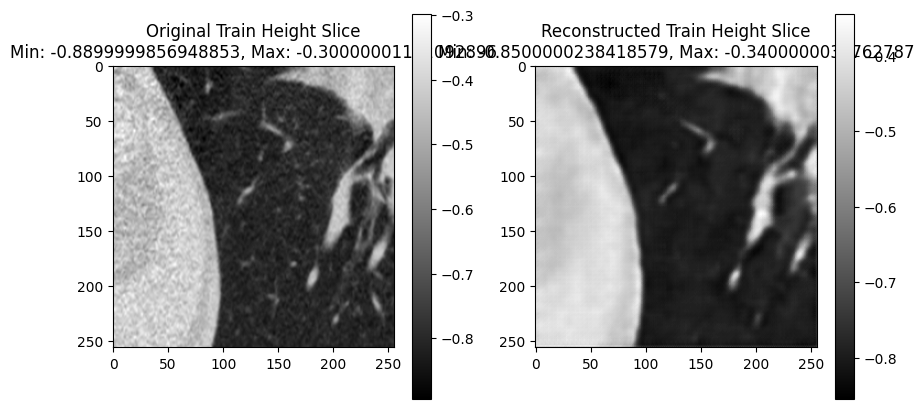

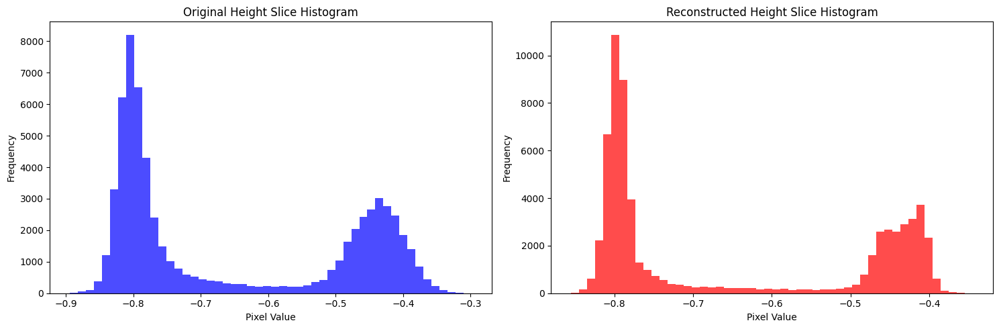

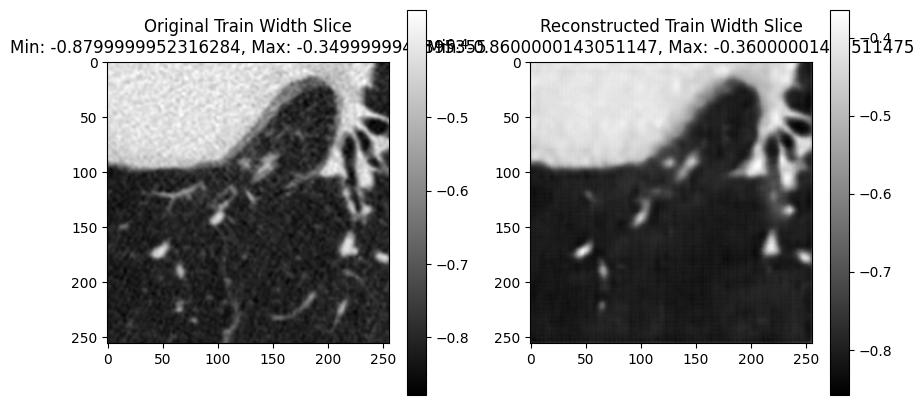

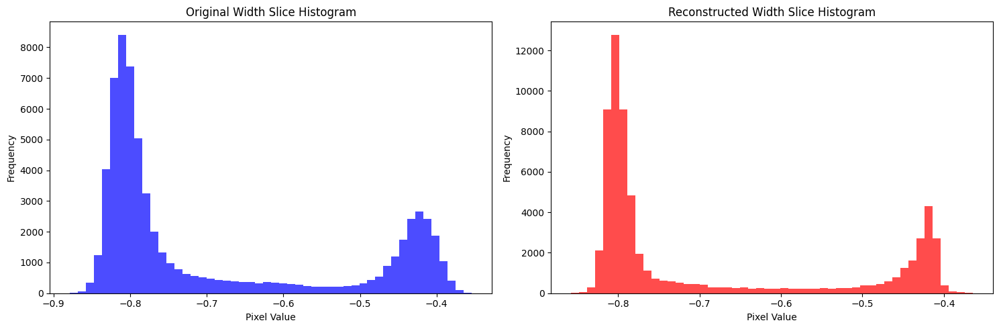

Validation: |          | 0/? [00:00<?, ?it/s]

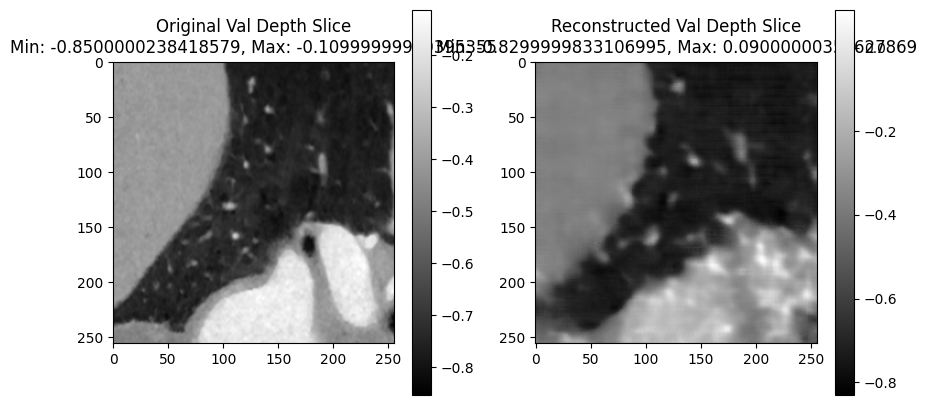

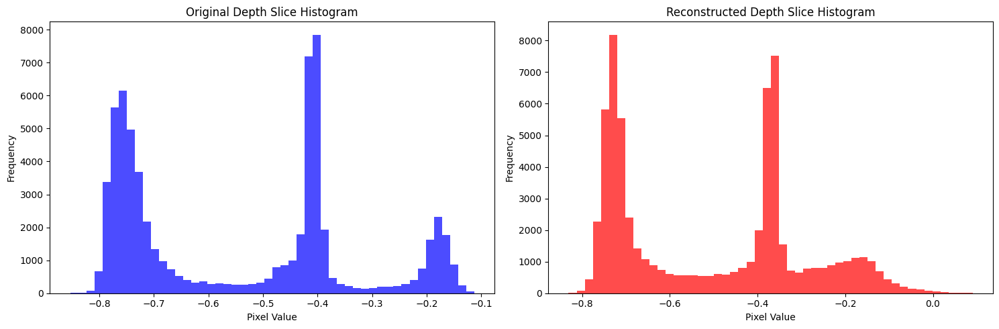

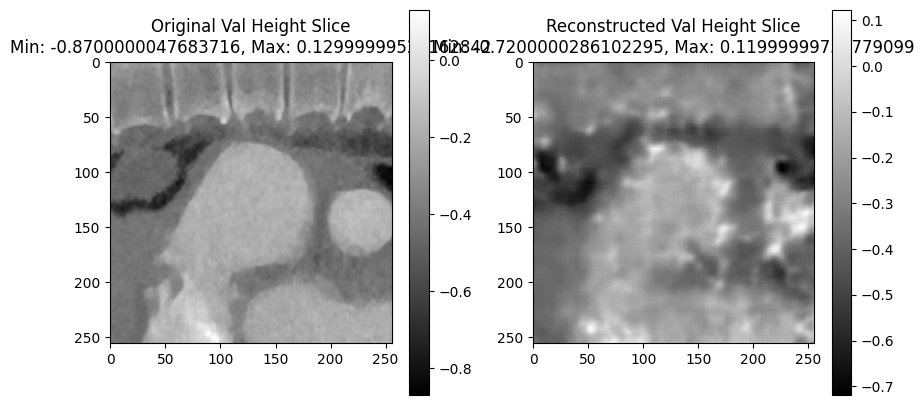

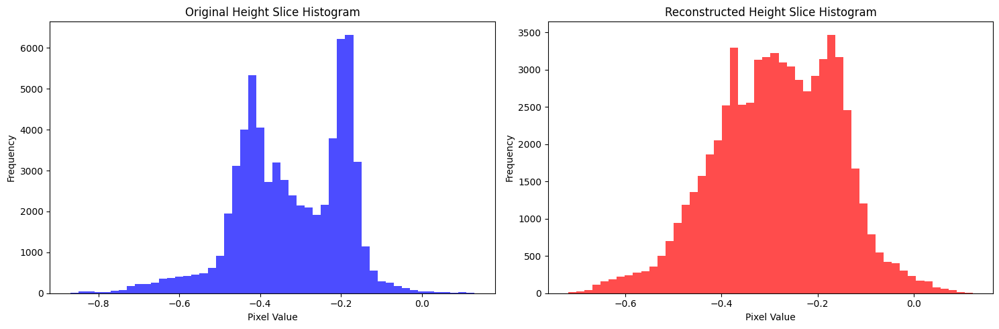

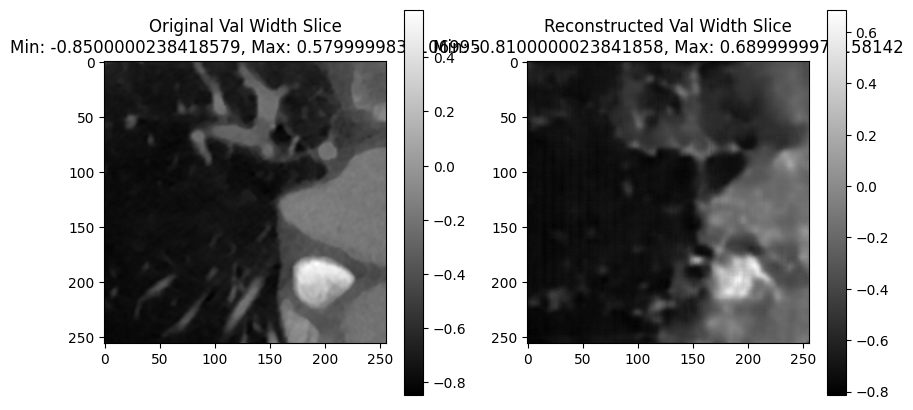

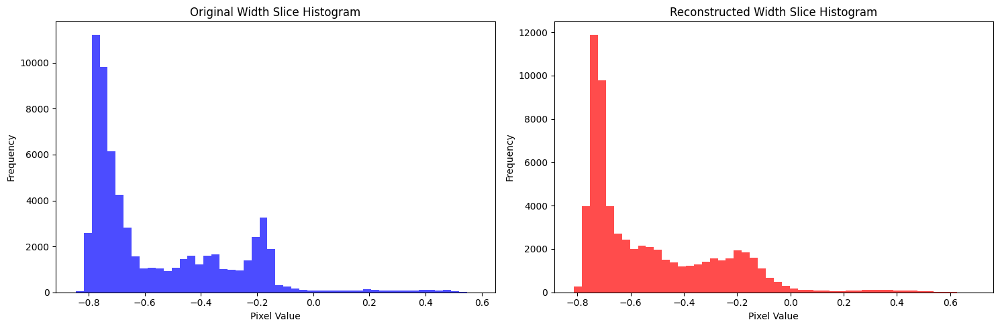

Time Spent 17805.76
Epoch: 1501


`Trainer.fit` stopped: `max_epochs=1501` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1387057      

In [5]:
# Initialize model and start training
ExperimentDescription = 'I-AE Job10 4C Loss'
ShowInterval = 300
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
# torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')